In [44]:
import numpy as np
from PIL import Image
import random
#from datasets import load_dataset
import torch
import json
import os
import base64
from tqdm import tqdm
import requests
from dotenv import load_dotenv
from IPython.display import display
from diffusers import DiffusionPipeline
from io import BytesIO
import transformers
import clip
from transformers import AutoTokenizer, AutoModelForCausalLM, BitsAndBytesConfig, AutoProcessor
from transformers import GenerationConfig, pipeline
from langchain import HuggingFacePipeline
from langchain import PromptTemplate, LLMChain
from promptcap import PromptCap
from langchain.prompts import (
    PromptTemplate,
    SystemMessagePromptTemplate,
    HumanMessagePromptTemplate,
    ChatPromptTemplate,
)
from langchain.schema.messages import HumanMessage, SystemMessage
from langchain_core.output_parsers import StrOutputParser
from langchain_openai import ChatOpenAI
from langchain.llms import OpenAI
from langchain import PromptTemplate, LLMChain
import matplotlib.pyplot as plt

In [1]:
import clip

/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [10]:
load_dotenv()

True

In [4]:
# vist dataset
extracted_data = []
combined_test_data = json.load(open('combined_test_data.json', 'r'))
for entry in combined_test_data:
    try:
        original_text = entry['caption']['original_text']
        image_url = entry['image_details']['url_o']
        extracted_data.append((original_text, image_url))
    except Exception as e:
        pass

In [5]:
random.seed(42)
test_data = random.sample(extracted_data, 500)
json.dump(test_data, open('vist_test_data_sampled.json', 'w'))

In [6]:
extracted_data[91]

('The food looked amazing at the meal.',
 'https://farm4.staticflickr.com/3205/2835095703_90e1151b4d_o.jpg')

It was a great day!


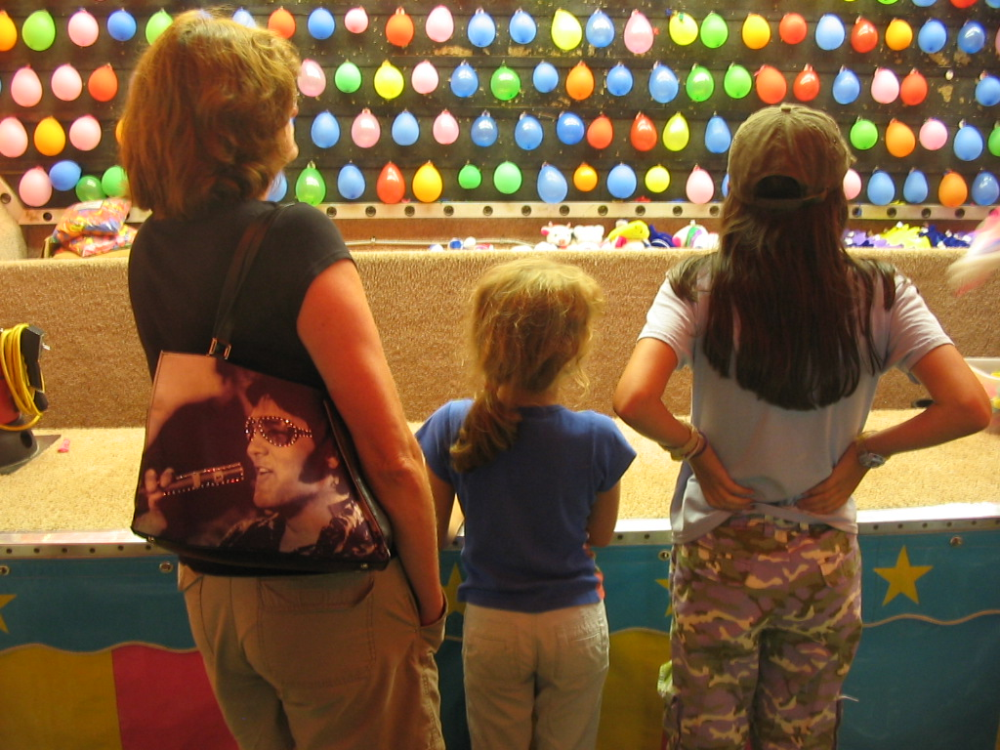

We had an exciting day at the fair!


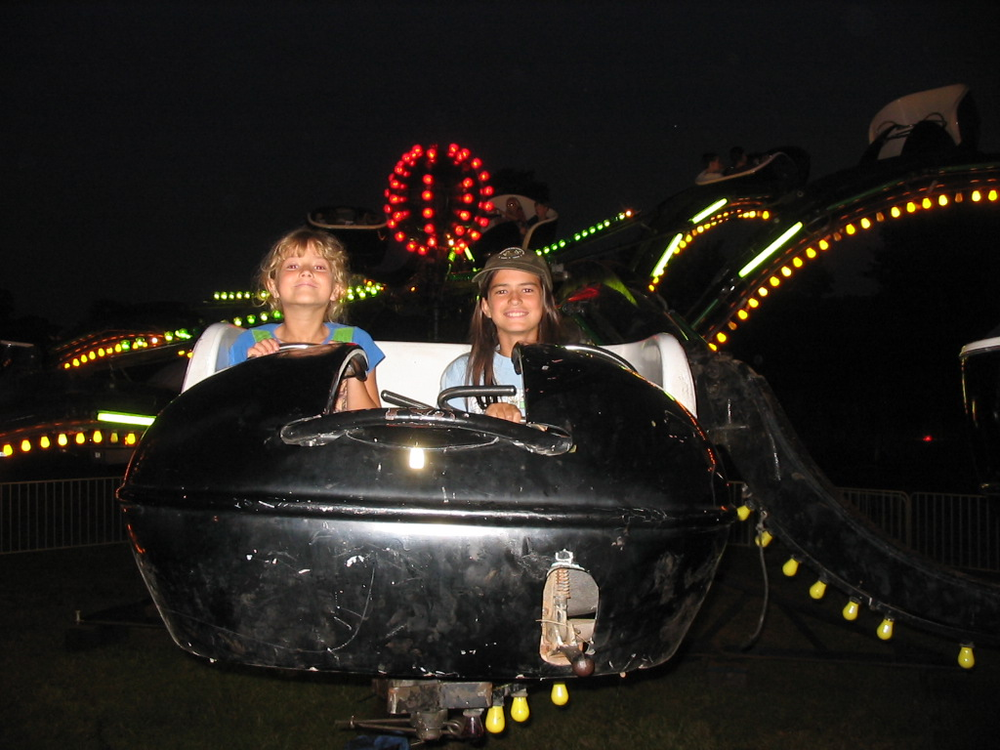

The lights lit up the night and the rides made us all dizzy.


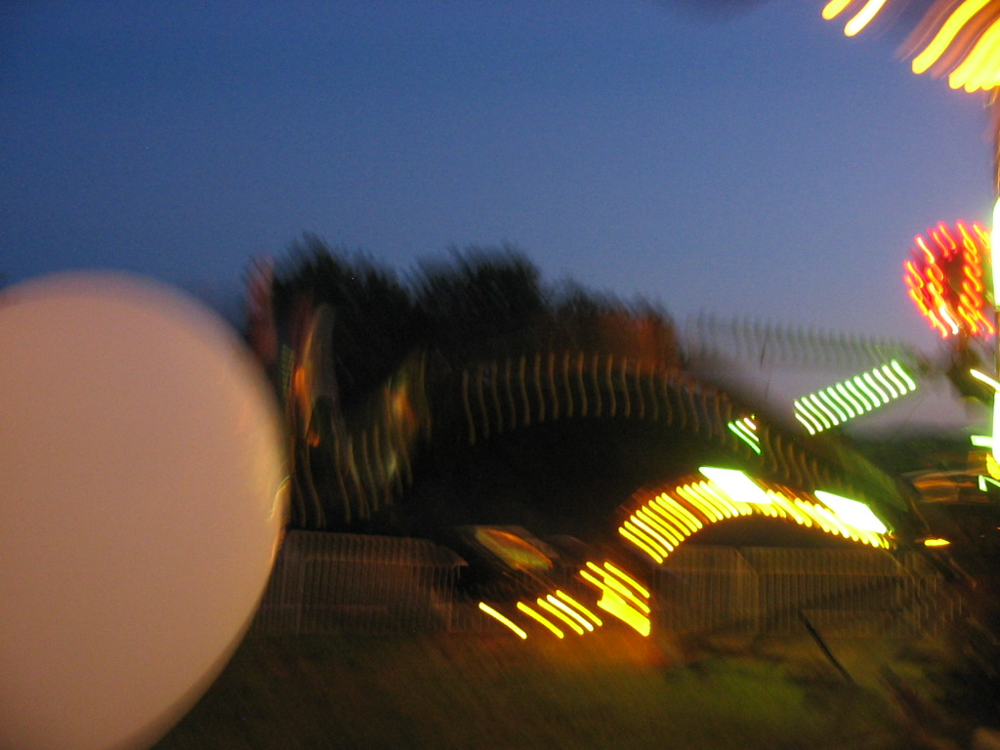

In [7]:
for caption, url in extracted_data[34:37]:
    response = requests.get(url)
    image = Image.open(BytesIO(response.content))
    print(caption)
    display(image)

In [11]:
chat_model = ChatOpenAI(model="gpt-3.5-turbo-0125", temperature=0)

In [12]:
def get_llm():
    
    bnb_config = BitsAndBytesConfig(
        load_in_4bit=True,
        bnb_4bit_use_double_quant=True,
        bnb_4bit_quant_type="nf4",
        bnb_4bit_compute_dtype=torch.bfloat16
        )

    #model_id = "meta-llama/Llama-2-7b-hf"



    model_id = "mistralai/Mistral-7B-Instruct-v0.2"
    model = AutoModelForCausalLM.from_pretrained(model_id, quantization_config=bnb_config, device_map="auto")
    tokenizer = AutoTokenizer.from_pretrained(model_id)
    
    
    #model = AutoModelForCausalLM.from_pretrained(model_id, quantization_config=bnb_config, device_map="auto")
    #tokenizer = AutoTokenizer.from_pretrained("meta-llama/Llama-2-7b-hf")
    #pipe = pipeline("text-generation", model=model, tokenizer=tokenizer, max_new_tokens=100)
    
    
    
    text_generation_pipeline = transformers.pipeline(
    model=model,
    tokenizer=tokenizer,
    task="text-generation",
    temperature=0.7,
    repetition_penalty=1.1,
    return_full_text=False,
    max_new_tokens=1000        )
    llm = HuggingFacePipeline(pipeline=text_generation_pipeline)
    
    
    return llm

llm = get_llm()

Loading checkpoint shards: 100%|██████████| 3/3 [00:06<00:00,  2.04s/it]


In [13]:
system_template = """
You are an AI assistant that generates detailed questions aimed at exploring deeper aspects of an image based on an initial caption provided by PromptCap.
"""

human_template = """
### [INST]
Instruction: Generate a list of detailed questions based on the initial caption provided. These questions should aim to explore deeper or unnoticed aspects of the image, ensuring a comprehensive understanding of the image's content. The questions should not be restricted to predefined key points but should dynamically adapt to the details provided in the caption.

Key strategies for formulating questions:
- Use the information in the initial caption to ask about specific objects, settings, or actions mentioned.
- Expand on subtle cues in the caption to inquire about underlying themes or additional details not explicitly described.
- Include questions that delve into the atmosphere, mood, or emotional tone of the image as implied by the caption.
- Ask about elements that might typically be overlooked but could be inferred from the overall context or style of the image.

Initial Caption: "{initial_caption}"
[/INST]"""

In [14]:
def get_mistral_response(initial_caption, system_template=system_template, human_template=human_template ):
    
    system_template = system_template

    human_template = human_template
    
    system_message_prompt = SystemMessagePromptTemplate.from_template(system_template)
    human_message_prompt = HumanMessagePromptTemplate.from_template(human_template)
    
    chat_prompt = ChatPromptTemplate.from_messages([system_message_prompt, human_message_prompt])
    
    caption_chain = LLMChain(llm=llm, prompt=chat_prompt)
    
    question = caption_chain.run(initial_caption=initial_caption)
        
    return question

In [15]:
gpt_system_template = """
You are an AI assistant tasked with generating a concise summary directly from a list of provided details about an image.
"""

gpt_human_template = """
Generate a concise description by summarizing the provided list of detailed answers without adding any additional information or interpretations. The summary should accurately reflect the content of the answers, condensing the main insights into a brief overview.

Detailed List of Answers: {answers_by_promptcap}
"""

In [16]:
def get_gpt_response(answers_by_promptcap, system_template=gpt_system_template, human_template=gpt_human_template ):
    
    system_template = system_template

    human_template = human_template
    
    system_message_prompt = SystemMessagePromptTemplate.from_template(system_template)
    human_message_prompt = HumanMessagePromptTemplate.from_template(human_template)
    
    chat_prompt = ChatPromptTemplate.from_messages([system_message_prompt, human_message_prompt])
    
    caption_chain = LLMChain(llm=llm, prompt=chat_prompt)
    
    concised_caption = caption_chain.run(answers_by_promptcap=answers_by_promptcap)
        
    return concised_caption

In [18]:
device = "cuda" if torch.cuda.is_available() else 'mps' if torch.backends.mps.is_available() else "cpu"
clip_model, preprocess = clip.load('ViT-B/32', device=device)

def clip_score(input1, input2):
    
    
    def encode_input(input_data):
        if isinstance(input_data, str):
            return clip_model.encode_text(clip.tokenize([input_data]).to(device))
        else:
            image_input = preprocess(input_data).unsqueeze(0).to(device)
            return clip_model.encode_image(image_input)

    with torch.no_grad():
        input1_features = encode_input(input1)
        input2_features = encode_input(input2)

        input1_features = input1_features / input1_features.norm(dim=-1, keepdim=True)
        input2_features = input2_features / input2_features.norm(dim=-1, keepdim=True)

        similarity_score = torch.matmul(input1_features, input2_features.T).item()

    return similarity_score

100%|████████████████████████████████████████| 338M/338M [00:03<00:00, 112MiB/s]


In [7]:
# loading promptcap

In [19]:
model = PromptCap("tifa-benchmark/promptcap-coco-vqa")  # also support OFA checkpoints. e.g. "OFA-Sys/ofa-large"
#if torch.cuda.is_available():
model = model.to("cuda")

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'GPTNeoXTokenizerFast'. 
The class this function is called from is 'OFATokenizer'.


tifa-benchmark/promptcap-coco-vqa
<super: <class 'OFATokenizer'>, <OFATokenizer object>>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [20]:
response = requests.get(list(test_data[57])[1])
img = Image.open(BytesIO(response.content))
bytes_stream = BytesIO()
img.save(bytes_stream, format='JPEG')
bytes_stream.seek(0)

0

In [22]:
prompt = "please describe this image according to the given question: What mood does the image convey?"

print(model.caption(prompt, bytes_stream))

a woman holding a glass of water in a room with people


In [24]:
test_data[:4]

[('Cyndi has time to watch TV before going to school. ',
  'https://farm7.staticflickr.com/6181/6070526561_339e05526b_o.jpg'),
 ('My sister recently graduated college.',
  'https://farm4.staticflickr.com/3325/3586730133_96c4437972_o.jpg'),
 ("I'm so glad they were able to save this beautiful house.",
  'https://farm4.staticflickr.com/3074/2809280551_e47e3399c7_o.jpg'),
 ('They make a handsome couple.',
  'https://farm1.staticflickr.com/47/147774706_4d83cfe67a_o.jpg')]

In [23]:
pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
pipe.to("cuda")

def get_image_response(prompt):
    image = pipe(prompt=prompt).images[0]
    
    img_byte_arr = BytesIO()
    image.save(img_byte_arr, format='PNG')
    img_byte_arr = img_byte_arr.getvalue()

    return img_byte_arr

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  6.48it/s]


In [32]:
results = []
prompt = "Please describe this image according to the given question: What mood does the image convey?"

for caption, url in tqdm(test_data[:70]):
    prompt_response_list = []
    questions_list = []

    try:
        response = requests.get(url)
        original_img = Image.open(BytesIO(response.content))
        original_img_bytes = BytesIO()
        original_img.save(original_img_bytes, format='PNG')
        original_img_bytes.seek(0)
        
        prompt_response = model.caption(prompt, original_img_bytes)
        questions = get_mistral_response(prompt_response)
        questions_list = [f"{question.strip()}?" for question in questions.split('?') if question.strip()]
        
        for question in questions_list:
            prompt_response = model.caption(question, original_img_bytes)
            prompt_response_list.append(prompt_response)
            
        concise_prompt = get_gpt_response(prompt_response_list)
        generated_image = get_image_response(concise_prompt) 
        generated_img = Image.open(BytesIO(generated_image))

        score = clip_score(original_img, generated_img)

        results.append({
            'caption': caption,
            'url': url,
            'initial_prompt_response':prompt_response,
            'questions': questions_list,
            'promptcap_response': prompt_response_list,
            'concise_response': concise_prompt,
            'generated_image': generated_image,
            'clip_score': score
        })
        
    except Exception as e:
        print(f"An error occurred: {e}")

  1%|▏         | 1/70 [00:00<00:09,  7.10it/s]

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a97c9e6b0>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the cake, and music plays in the background as they express emotions duri

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8ac76b31f0>
An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a97939670>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

  9%|▊         | 6/70 [02:08<22:23, 20.99s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: User

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8ac770bc90>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 29%|██▊       | 20/70 [12:09<29:22, 35.24s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a974418f0>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['as men in suits.']
The following part of your input was truncated because

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a978ef470>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 37%|███▋      | 26/70 [15:21<22:26, 30.60s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8ac7681670>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 66%|██████▌   | 46/70 [31:20<17:17, 43.24s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8ac7994220>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 74%|███████▍  | 52/70 [35:51<11:46, 39.27s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8ac7734c20>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 89%|████████▊ | 62/70 [43:06<05:14, 39.33s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a965a6bb0>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 94%|█████████▍| 66/70 [45:12<02:09, 32.50s/it]

An error occurred: cannot identify image file <_io.BytesIO object at 0x2b8a965a6bb0>


/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.7` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.

 97%|█████████▋| 68/70 [45:54<00:54, 27.36s/it]/mnt/home/pandavis/anaconda3/envs/stt890_rila/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:492: Use

In [38]:
def bytes_to_base64_str(bytes_data):
    return base64.b64encode(bytes_data).decode('utf-8')

for entry in results:
    entry['generated_image_bytes'] = bytes_to_base64_str(entry['generated_image'])
    del entry['generated_image']

json.dump(results, open('promptcap_vist_results.json', 'w'))

In [41]:
def display_images(original_image_url, refined_image_base64):
    
    response = requests.get(original_image_url)
    original_image = Image.open(BytesIO(response.content))
    
    refined_image_data = base64.b64decode(refined_image_base64)
    refined_image = Image.open(BytesIO(refined_image_data))

    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(original_image)
    ax[0].set_title('Original Image')
    ax[0].axis('off')

    ax[1].imshow(refined_image)
    ax[1].set_title('PromptCap Generated Image')
    ax[1].axis('off')

    plt.show()

Caption: We went back to another friends place so continue catching up.

 Initial Prompt Response: a man cutting a cake with a knife with music playing in the background

 Questions Generated: ['1. What type of cake is being cut among the group of people?', '2. How many people are there in the group and what are their expressions while cutting the cake?', '3. Is this a celebration event or just a casual gathering?', '4. What are the decorations on the walls and tables in the room that suggest the occasion?', '5. Are there any children present in the group and how do they react to the cake-cutting ceremony?', '6. What are the ages and genders of the people in the group?', '7. What are the people wearing and how does their attire reflect the occasion?', '8. Is there any visible food or drink other than the cake in the room?', '9. What emotions can be discerned from the facial expressions and body language of the people?', '10. Is there any significant object or symbol in the room that ad

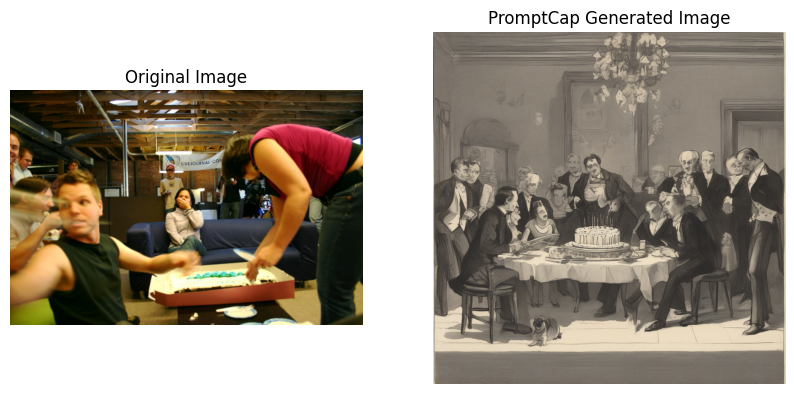





Caption: everyone was satisfied at the end. 

 Initial Prompt Response: three men sitting at a bar

 Questions Generated: ['1. What specific drinks do each of the three men have in front of them on the bar counter?', '2. Are there any visible brand labels or unique features of their drinks that can be identified?', '3. What are the expressions on the faces of the three men that suggest they are happy?', '4. Is there any body language or posture that indicates camaraderie among the men?', '5. What is the age range and appearance of the three men?', '6. Is there any noticeable difference in their attire or demeanor that sets them apart?', '7. What is the ambiance of the bar setting like - dimly lit, brightly lit, noisy, quiet, etc.?', '8. Are there any other patrons or staff present in the bar scene?', '9. What time of day does the scene appear to depict - early morning, afternoon, evening, late night?', '10. Is there any indication of a special occasion or celebration that might exp

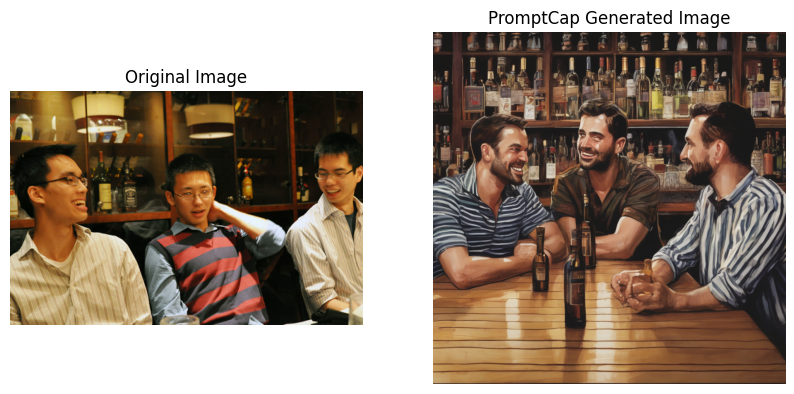





Caption: The sunset means night is coming soon to the town.

 Initial Prompt Response: people walking around a flagpole with shadows cast by the flagpole

 Questions Generated: ['1. What is the size and design of the flag that is being hoisted up the flagpole?', '2. How many people are in the group, and what are their expressions suggesting about their emotions towards the event?', '3. Is there any visible symbolism or significance associated with the flag or the gathering around it?', '4. What are the attire and body language of each person indicating about their social status, occupation, or affiliations?', '5. Are there any other structures or landmarks present in the scene that can provide context to the location of this event?', '6. What colors does the sunset display, and how do they influence the overall mood and ambiance of the image?', '7. Is there any evidence of wind or weather conditions affecting the flag, the people, or the environment?', '8. Are there any animals, ve

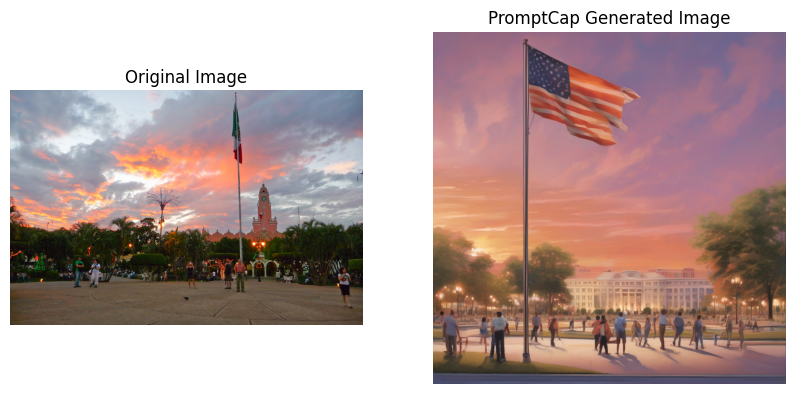





Caption: Some of the other costumes were very good too.

 Initial Prompt Response: a woman in a costume with a hat on her head

 Questions Generated: ['1. What type of costume is the woman wearing, and what cultural or historical significance does it hold?', '2. Why is the woman holding her hat in the air, and what emotion does this gesture convey?', '3. What is the setting of the image, and how does it contribute to the overall scene?', "4. Is there anyone else present in the image, and if so, how do they react to the woman's behavior?", '5. What materials is the hat made of, and what symbolism might be associated with its shape or design?', '6. Are there any other props or accessories visible in the image that might provide additional context or meaning?', "7. How does the woman's expression look like, and what emotions might she be feeling based on her facial features and body language?", "8. Is there any text or writing visible in the image that could offer further insight into

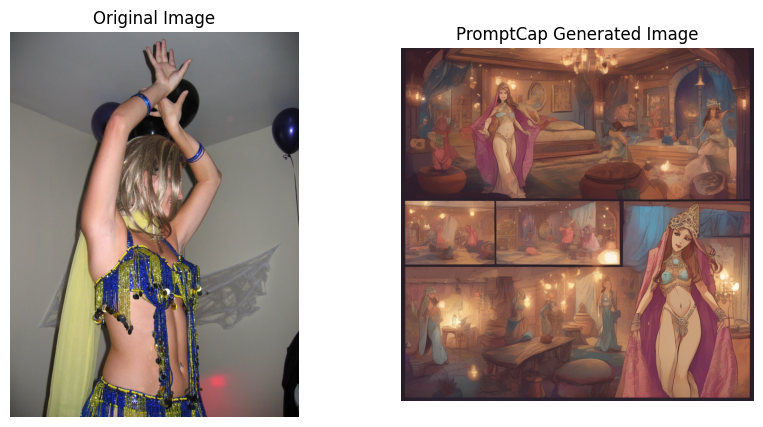





Caption: The unit rehearsed for the big event. 

 Initial Prompt Response: a group of soldiers walking in a parking lot with lighting

 Questions Generated: ['1. What type of military formation do the soldiers appear to be marching in?', '2. Can you identify any distinguishing features or insignia on the uniforms of the soldiers?', '3. What is the expression on the faces of the soldiers as they march?', 'Are they focused, tired, or enthusiastic?', '4. Is there a band playing music or any other audible sounds in the scene?', 'If so, what kind of music is being played?', '5. What flags or banners can be seen in the background of the image?', '6. Are there any civilians or spectators present in the crowd watching the parade?', 'How do they react to the soldiers passing by?', '7. What time of day does the parade seem to be taking place?', 'Can you see any clues in the image that suggest this?', '8. Is there any evidence of a particular holiday or commemoration being celebrated in the i

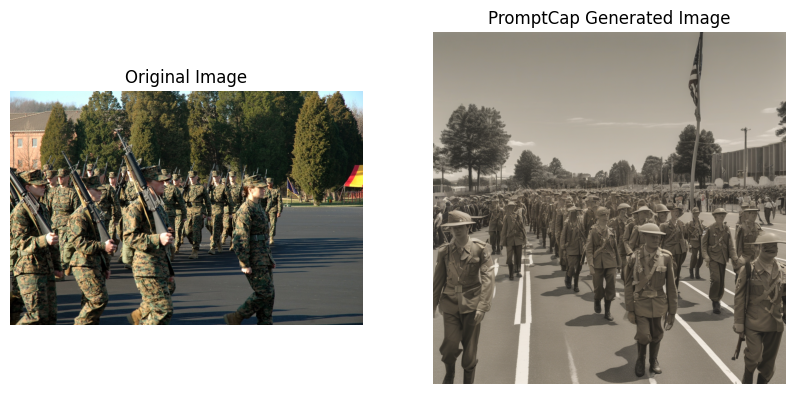





Caption: Sam and Al smile at the big event.

 Initial Prompt Response: a man and a woman posing for a picture

 Questions Generated: ["1. What are the expressions on the man and woman's faces that make them smile?", 'Are their smiles genuine or forced?', '2. What is the setting of the photograph - indoors or outdoors?', 'If outdoors, what time of day is it?', '3. What are the man and woman wearing, and how do their clothes contribute to the overall mood of the image?', '4. Is there any visible body language between the man and woman that suggests a relationship or connection?', '5. What objects can be seen in the background of the photograph, and how do they relate to the man and woman?', "6. Are there any visible facial features or accessories that provide clues about the man and woman's age, ethnicity, or personality?", '7. What emotions might the man and woman be feeling beyond just smiling?', 'Happiness, love, relief, etc.?', '8. Is there any visible context that suggests why t

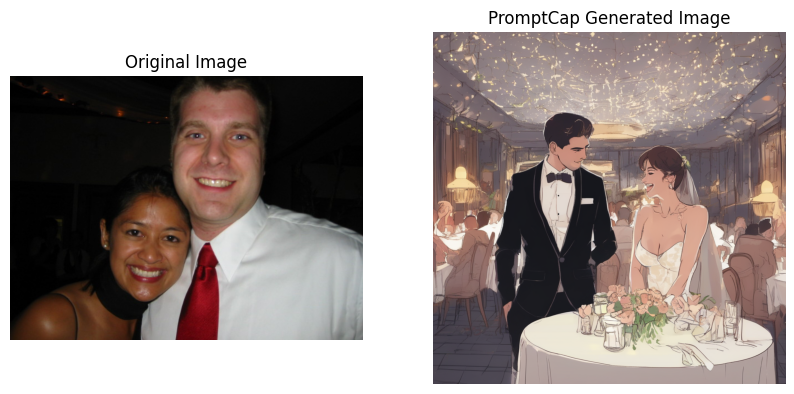





Caption: wish turned out to be very delicious

 Initial Prompt Response: a bowl of food with a spoon

 Questions Generated: ['1. What type of food is in the bowl, and can you describe its texture and appearance?', '2. Is there any steam rising from the bowl, suggesting that the food is freshly cooked?', '3. What color is the spoon, and does it have any distinctive markings or designs?', '4. Is the spoon placed in the bowl in a particular way, such as horizontally or vertically?', '5. Are there any other objects visible in the image that might provide context for the scene, like a tablecloth or a plate?', '6. Does the image give any indication of where this scene takes place, such as a kitchen or a dining room?', '7. What emotions might be conveyed through the arrangement of the spoon and the food in the bowl?', '8. Is there any lighting present in the image that affects the way the food looks?', '9. Are there any reflections or shadows in the bowl that reveal additional details abo

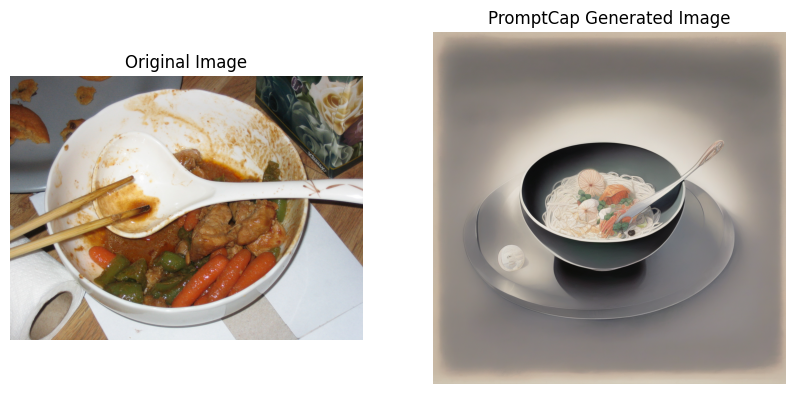





Caption: Traditional is still the way to go for the flower girl and ring bearer.

 Initial Prompt Response: warm and heartfelt

 Questions Generated: ["1. What is the expression on the little girl's face as she holds the man's hand?", 'Is it one of joy, curiosity, or apprehension?', '2. Where and when does this scene take place, based on the appearance of the surroundings and the clothing of the characters?', '3. What is the relationship between the little girl and the man?', 'Are they father and daughter, grandfather and granddaughter, or something else entirely?', '4. Why is the man wearing formal attire while the little girl is dressed in a white dress?', 'Is there a special occasion or event taking place?', '5. How old do the little girl and man appear to be?', 'What can we infer about their ages based on their physical features and body language?', "6. What emotions does the man seem to be experiencing as he holds the little girl's hand?", 'Is he happy, proud, or protective?',

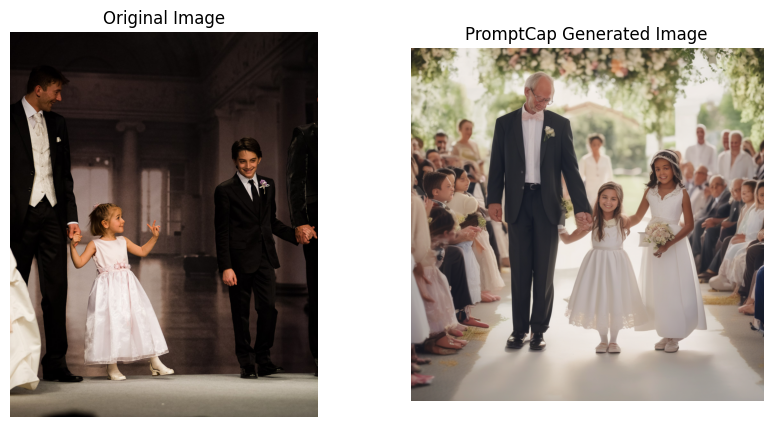





Caption: We are having a few friends over this evening. Time to make some cocktails.

 Initial Prompt Response: a man and a woman standing in a kitchen

 Questions Generated: ['1. What type of beer is the man and woman holding in their hands?', '2. Are they sharing the bottle or each having their own glass?', '3. What expressions do their faces convey while holding the beer?', '4. Is there any other object or detail visible in the kitchen that can provide context to their interaction?', '5. Why are they in the kitchen with a bottle of beer?', '6. Is this a casual moment or does it suggest a more significant event?', '7. What time of day is it based on the lighting conditions in the kitchen?', '8. Does the kitchen have any distinctive features or decorations that add to the scene?', '9. How old do the man and woman appear to be?', '10. Is there any body language or posture that suggests tension, intimacy, or friendship between them?', '11. What emotions might be driving their decisi

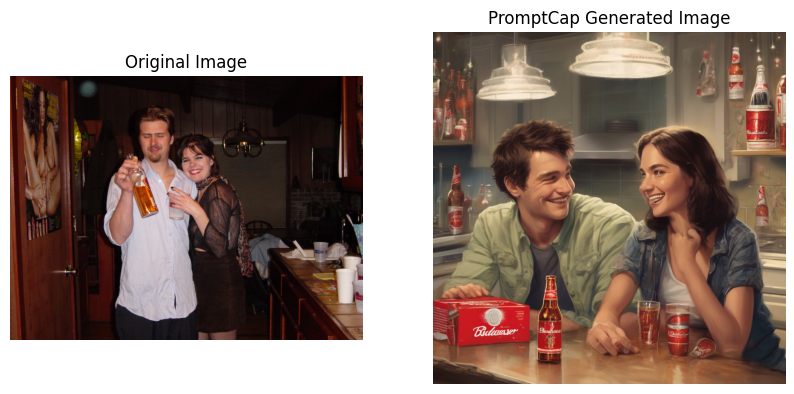





Caption: All these wonderful faces coming together makes me smile.

 Initial Prompt Response: a group of people sitting around a table with a notable details in the image

 Questions Generated: ['1. What type of drinks are there on the table, and how many does each person have?', '2. Are the people engaged in a conversation, or do they seem lost in thought?', '3. What is the expression on the faces of the individuals, suggesting their mood or emotions?', '4. Is there any particular setting or decoration that can be identified in the background?', '5. What is the seating arrangement like - is it formal or casual?', '6. Are there any noticeable differences between the drinks or glasses, indicating anything special about the occasion?', '7. How close or far apart are the people seated, hinting at their level of comfort or familiarity with one another?', '8. Is there any visible body language or gestures that suggest tension, excitement, or relaxation among the group?', '9. What is the

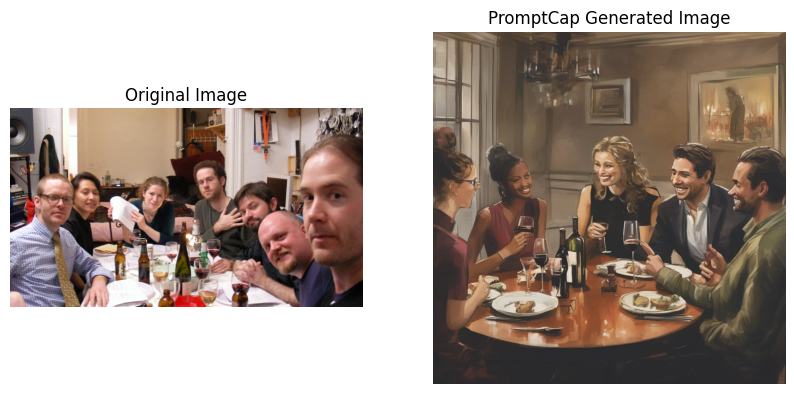





Caption: And uncle Bob did the preaching.

 Initial Prompt Response: a man holding a cell phone

 Questions Generated: ["1. What is the exact color and shade of the man's yellow shirt?", '2. Is the man standing still or moving when he holds the cell phone?', "3. What is the expression on the man's face other than the smile?", 'Are there any wrinkles around his eyes suggesting laughter or amusement?', '4. What is the background of the image like?', 'Is it a busy urban scene, a quiet suburban neighborhood, or something else entirely?', '5. What type of cell phone does the man hold?', 'Can we make out any distinguishing features such as brand logos or screen size?', '6. Why is the man smiling?', 'Is he talking to someone on the phone, or has he just received good news?', '7. Does the man appear to be alone in the image, or is there someone or something else present?', "8. How does the man's body language convey emotion or intent?", 'Is he relaxed, tense, or excited?', '9. Is there any

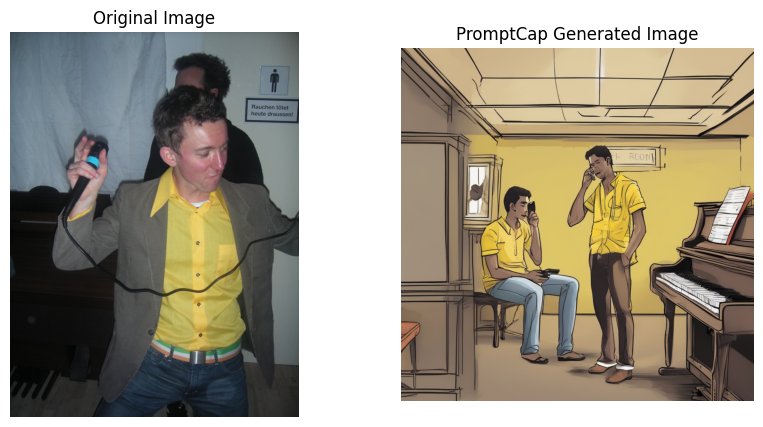





Caption: Afterwards the group began to eat and drink, making merry knowing that it would be another year before they would visit again. 

 Initial Prompt Response: a group of people standing around a table with a bottle of wine with notable textures and colors

 Questions Generated: ['1. What type of wine is in the bottle, and can you identify any distinguishing features or labels?', '2. How many people are in the group, and what are their expressions suggesting about their emotions towards the gathering?', '3. Is there any particular setting or decoration visible in the background that may provide context to the occasion?', '4. Are there any glasses or utensils present on the table, indicating whether this is a casual or formal event?', '5. What body language or postures do the individuals exhibit, and how do these suggest relationships among them?', '6. Is there any evidence of food being consumed or prepared nearby, and if so, what types?', '7. Are there any notable clothing sty

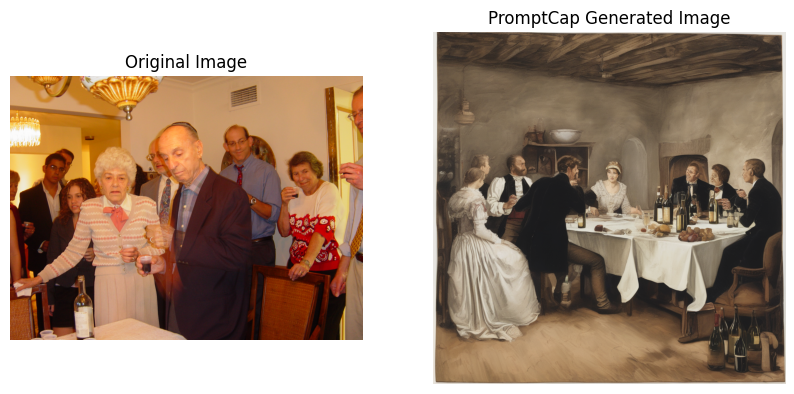





Caption: Winter was very severe this year.

 Initial Prompt Response: a sign on a building in a city street with cultural implications

 Questions Generated: ['1. What specific type of city street is depicted in the image, and how does its architecture contribute to the overall scene?', '2. Can you describe the appearance and color palette of the sign with the first rule of investing, and what does it suggest about the nature of the investment advice being given?', '3. Are there any other visible signs or advertisements in the image, and how do they contrast or complement the sign with the investment rule?', '4. What kind of vehicles can be seen on the street, and how do they add to the ambiance of the scene?', '5. Is there any evidence of people present in the image, and if so, how do their actions or expressions relate to the investment sign?', '6. How does the lighting in the image affect the visibility and readability of the sign, and what does this suggest about the time of da

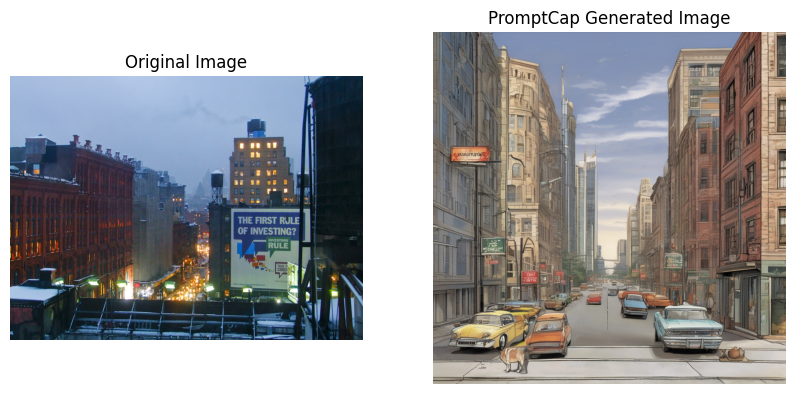





Caption: I was so styling my curlers. "Don't look at me I'm hideous!" I cried my lines. 

 Initial Prompt Response: a woman sitting at a table with bottles of wine

 Questions Generated: ['1. What type of table does the woman sit at, and what is its condition?', '2. How many bottles of wine are there on the table, and what are their labels indicating?', '3. Is the woman alone, or is there someone else present in the image?', 'If so, where are they located?', '4. What is the woman wearing, and how does her attire contribute to the scene?', '5. Are there any food items or other objects on the table besides the bottles of wine?', '6. What expression does the woman have on her face, and how does it relate to the setting?', '7. Is there any visible lighting in the scene, and how does it affect the mood?', '8. What is the background of the image like, and how does it interact with the foreground elements?', '9. Does the woman appear to be drinking from one of the bottles, or is she just 

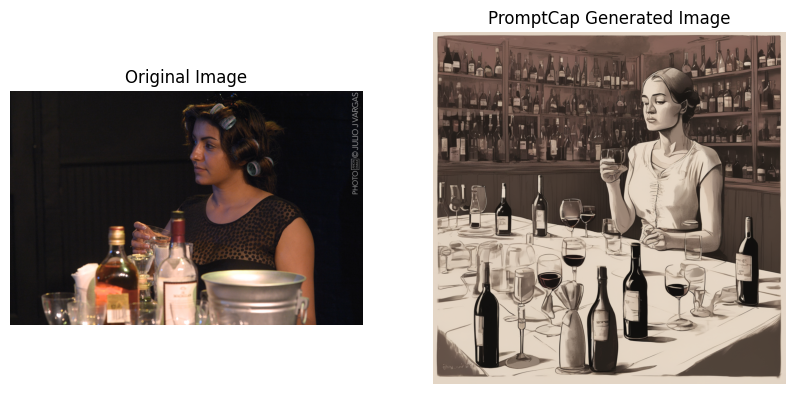





Caption: Mom went up first and scored a ton of points.

 Initial Prompt Response: a pink bowling ball

 Questions Generated: ['1. What expression does the child have on their face as they throw the pink bowling ball?', '2. Is there anyone else present in the bowling alley during this moment?', 'If so, what are they doing?', '3. How old do you estimate the child to be based on their size and appearance?', '4. What is the texture and material of the pink bowling ball like?', '5. Are there any distinctive features or markings on the pink bowling ball?', '6. What is the lighting condition in the bowling alley, and how does it affect the mood of the scene?', '7. Does the child seem focused on the game, or is there something else capturing their attention?', "8. What can we infer about the child's skill level based on their body language and the position of the pins after the ball is thrown?", '9. Is the bowling alley empty or crowded?', "How does the presence (or absence) of other peopl

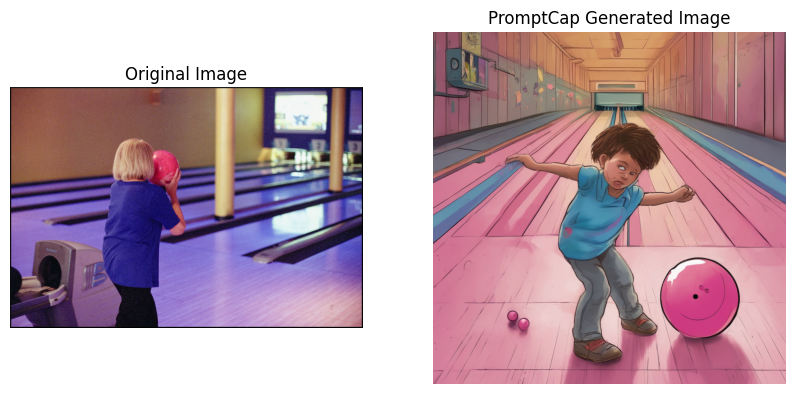





Caption: Some of our costumes are really amazing today.

 Initial Prompt Response: two women with skull makeup and hats

 Questions Generated: ['1. What type of skull makeup are the two women wearing, and how is it applied on their faces?', '2. Are there any distinct features or patterns in the skull makeup that can be identified?', "3. What colors are predominantly used in the skull makeup, and how do they contrast with the women's clothing or surroundings?", '4. Why do you think the two women are wearing skull makeup?', 'Is it a fashion statement, a cultural tradition, or something else?', '5. What types of hats are the women wearing, and how do they complement their skull makeup?', "6. How do the expressions on the women's faces convey emotion or attitude towards each other or their appearance?", '7. Are there any visible tattoos or body modifications on the women besides the skull makeup and hats?', '8. What is the setting or background of the image, and how does it contribute 

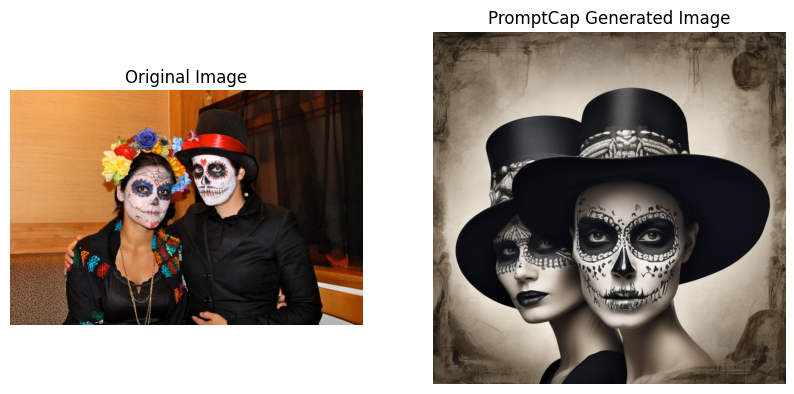





Caption: The outdoor area was nicely designed.

 Initial Prompt Response: a view of a park with palm trees and benches

 Questions Generated: ['1. What type of palm trees can be seen in the park?', 'Are they mature or young?', '2. How many benches are there in the park?', 'Are they evenly distributed or clustered?', '3. What activities are people engaging in around the benches?', '4. Is there any body of water present in the park?', 'If so, what kind and how does it interact with the palm trees?', '5. Are there any other notable structures or features in the park besides the palm trees and benches?', '6. What is the weather like in the park?', 'Does it affect the appearance of the palm trees or the comfort of the benches?', '7. How do the shadows cast by the palm trees contribute to the lighting in the park?', '8. Are there any animals or birds present in the park that interact with the palm trees or benches?', '9. What time of day is it in the image?', 'How does this affect the mo

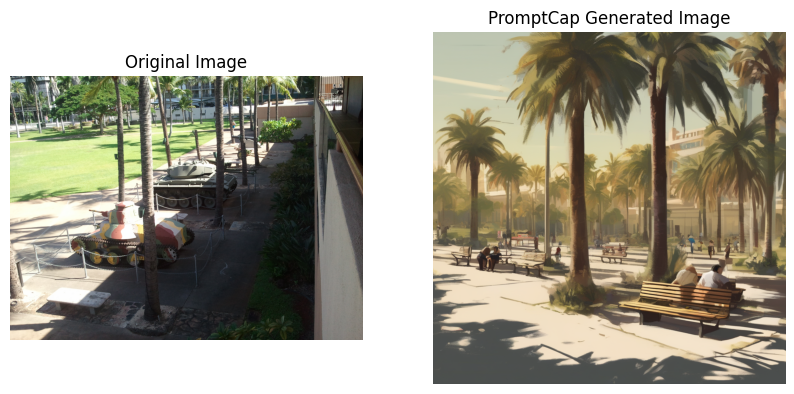





Caption: We listened to the keynote speeches from up on the catwalk.

 Initial Prompt Response: two men and a woman standing on a bridge with a microphone

 Questions Generated: ['1. What is the expression on the face of each person in the image?', 'Are they showing any signs of emotion?', '2. What are the two other people doing while the man holds the microphone?', '3. Is there a visible audience or crowd in the background?', 'If so, how large is it and what are their reactions?', '4. What type of event or setting does the scene suggest (e.g., political rally, concert, news broadcast)?', '5. What are the clothing styles and body language of the three individuals, and how do these factors contribute to the overall impression of the image?', '6. Can you identify any distinguishing features or accessories of the man, such as a logo on his shirt or a distinctive piece of jewelry?', '7. How close or far apart are the three individuals standing?', 'Does this arrangement convey a sense o

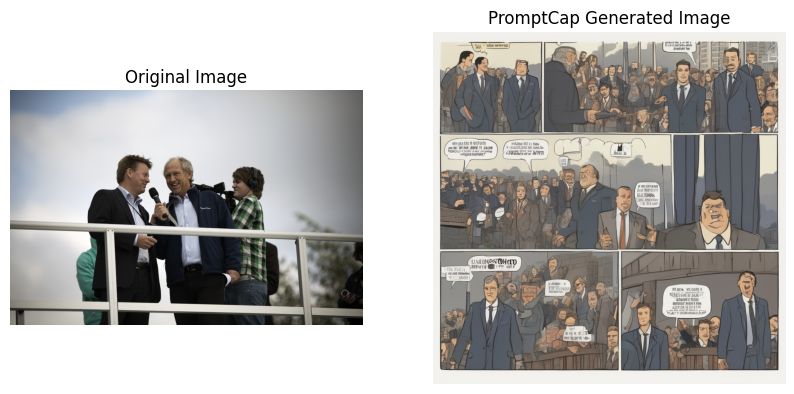





Caption: now it is time to sleep. everyone is in the bed and ready to call it a night.

 Initial Prompt Response: a woman in a hotel room with two children in bed

 Questions Generated: ['1. What is the expression on the faces of the two children while they lie in bed with the woman?', 'Are they also smiling or do they have different emotions?', '2. Why is the woman smiling in this moment?', 'Is she amused by something, comforting the children, or experiencing her own joy?', '3. What time of day does the scene depict?', 'Can we infer any clues from the position of the sun or other environmental factors?', '4. What type of bedding is visible in the image?', 'Does it suggest a particular culture, socioeconomic status, or personal preference?', "5. Are there any notable details in the background of the image that may provide insight into the woman's life or the context of the scene?", '6. How old are the children estimated to be based on their appearance and size in relation to the wo

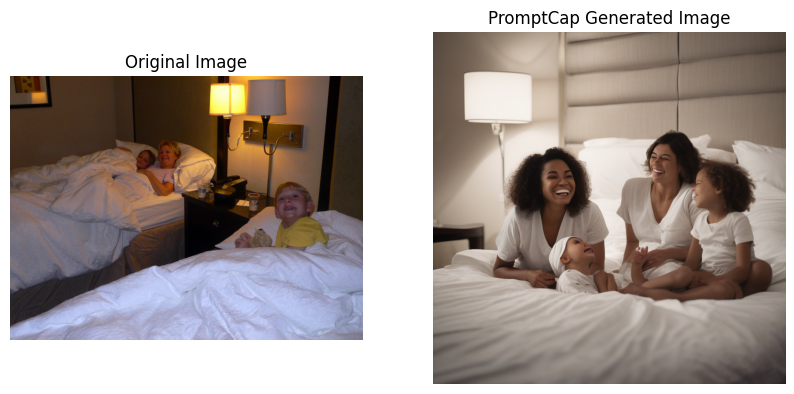





Caption: Parents and children dressed up for the school Halloween walk.

 Initial Prompt Response: a woman and two girls in costumes

 Questions Generated: ['1. What types of costumes are the woman and the two girls wearing?', 'Are there any distinctive features or symbols on their costumes that can provide further context?', '2. Where is this photograph being taken?', 'Is there any recognizable landmark or setting in the background?', '3. What expressions do the woman and the girls have on their faces?', 'How do these expressions convey emotion or mood?', '4. What props or accessories do they have with them?', 'Do these items add any significance to the scene?', '5. Can you identify the occasion or event that this photograph might be taken for?', '6. What is the relationship between the woman and the two girls?', 'Are they family members, friends, or acquaintances?', '7. How does the lighting in the photograph affect the overall appearance and mood of the scene?', '8. Are there an

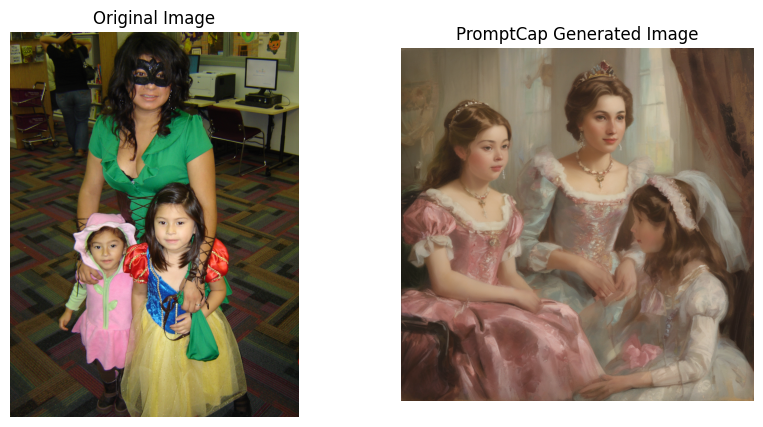





Caption: The beautiful setup for the wedding reception.

 Initial Prompt Response: a table with a cake and a sign on it with clues at the time period in which the scene takes place

 Questions Generated: ['1. What type of cake is on the table, and what can we infer about its significance based on its appearance?', '2. What does the sign say, and how does its message relate to the cake or the overall scene?', '3. Who do you think made the cake, and why was it likely made for this particular occasion?', '4. What other items are present on the table besides the cake and the sign, and how do they contribute to the scene?', '5. Is there any indication of who the intended audience for the cake and the sign might be?', '6. How does the lighting in the image affect the way the cake and the sign appear?', '7. Are there any textures, colors, or patterns in the image that stand out and deserve further investigation?', '8. Based on the overall composition of the image, what emotions or feeling

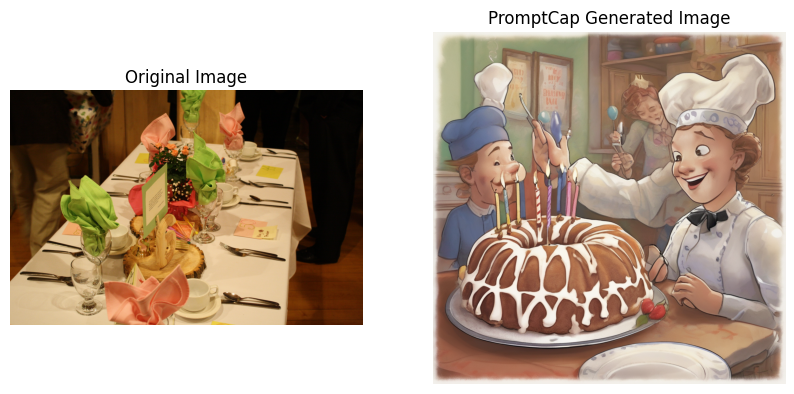





Caption: These men are hard workers and are trying their best to get ahead in life.

 Initial Prompt Response: a man in a military uniform sitting at a table with a pen

 Questions Generated: ['1. What type of military uniforms are the men wearing, and what insignia or symbols can be seen on their uniforms?', '2. Are there any visible rank insignia or badges among the men, and if so, what do they represent?', '3. What appears to be the purpose or activity of the group, based on their body language and facial expressions?', '4. Is there any writing or markings on the paper in front of them, and if so, what does it say or represent?', '5. What is the setting or location where the scene takes place, and how does it contribute to the overall mood or tone of the image?', "6. Are there any other objects or props present in the image that might provide clues about the men's mission or intentions?", '7. How does the lighting in the image affect the mood or tone, and what emotions might the

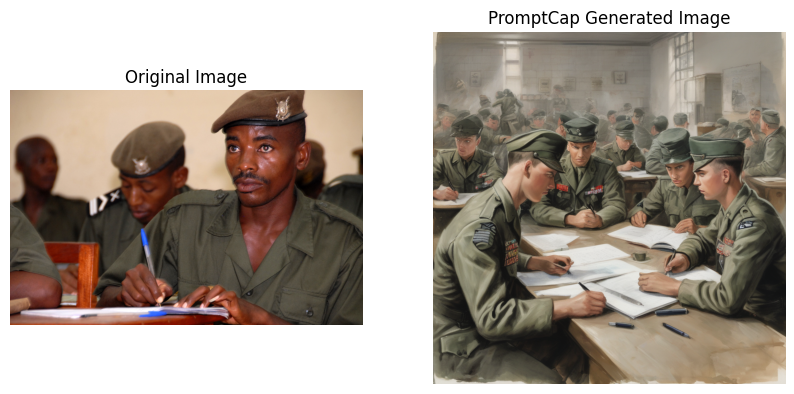





Caption: I bought several that made me happy about coming to this event.

 Initial Prompt Response: a hot air balloon flying over a mountain

 Questions Generated: ['1. What specific colors and shades are used to depict the hot air balloon in the drawing?', '2. Can you identify any distinct features or patterns on the surface of the hot air balloon?', '3. How does the size and scale of the hot air balloon compare to the surrounding mountains in the drawing?', '4. What type of basket or gondola is attached to the bottom of the hot air balloon?', '5. Are there any recognizable landmarks or geographical features visible among the mountains in the background?', '6. What weather conditions are suggested by the appearance of the sky in the drawing?', '7. Does the drawing convey a sense of motion or stability with regards to the hot air balloon?', '8. What emotions or feelings might the artist have been trying to evoke through this particular composition?', '9. Is there any vegetation or 

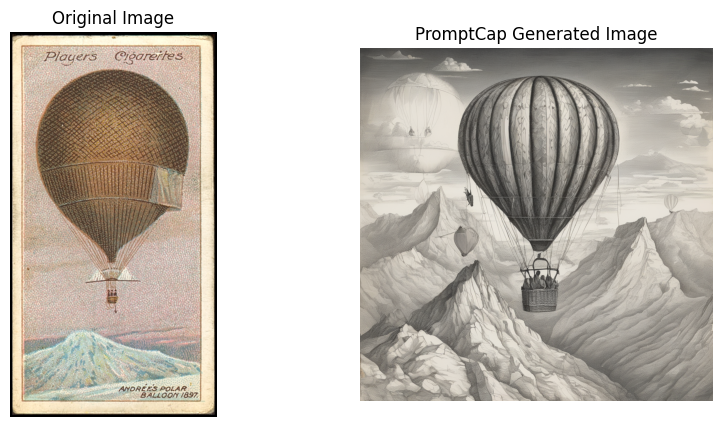





Caption: Here I am trying to figure out how to eat more without telling anyone.

 Initial Prompt Response: a man sitting at a table eating a sandwich

 Questions Generated: ['1. What type of food is the man holding in his hand?', '2. Is the man eating alone or with someone else in the image?', "3. What is the expression on the man's face as he holds the food?", 'Does it suggest enjoyment, sadness, or something else?', '4. What is the setting of the scene?', 'Is it indoors or outdoors?', "5. What can we infer about the man's personality or character based on his posture and body language?", '6. Are there any other objects or details visible in the image that might provide context or clues about the man or the situation?', "7. What is the significance of the man's attire or clothing?", '8. Is there any evidence of a meal being prepared or already consumed in the scene?', '9. How does the lighting in the image contribute to the mood or atmosphere?', "10. Is there any symbolism or meta

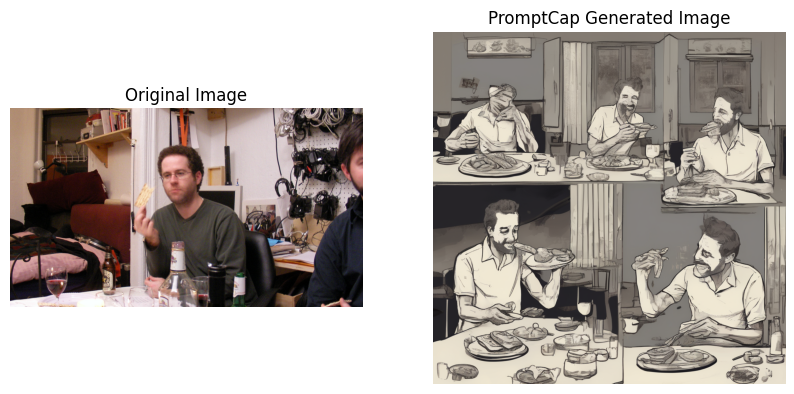





Caption: Here he is now. 

 Initial Prompt Response: a bird sitting on a yellow pole

 Questions Generated: ['1. What type of bird is it, and what distinguishing features can be observed from its appearance?', '2. Is the bird singing or engaged in any other behavior?', 'Why do you think so?', '3. What is the size and shape of the window, and what can be seen through it?', '4. How close is the bird to the window, and what is the distance between them?', '5. What is the texture and color of the pole, and how does it contrast with the surrounding environment?', '6. Are there any visible wires or other structures attached to the pole?', '7. What time of day is it, and how does the light affect the scene?', '8. What emotions or feelings does the image evoke, and why?', '9. Is there any significance to the presence of the bird in front of the window?', '10. What might have attracted the bird to this particular location?', '11. Are there any other birds or animals nearby, and how do they 

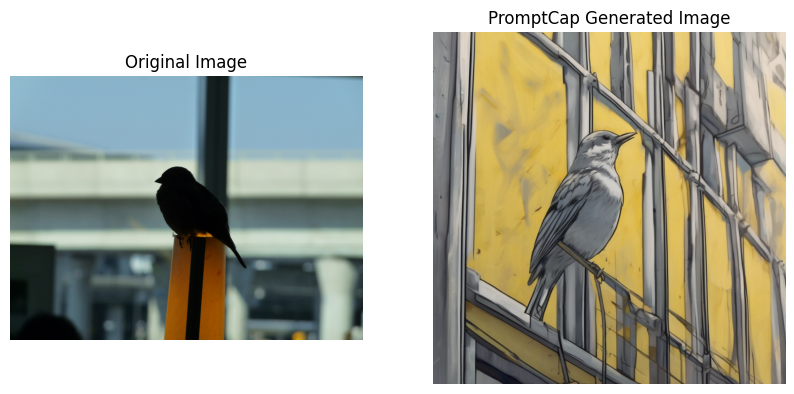





Caption: At the end of they day, there was an entire table full of jack o lanterns.

 Initial Prompt Response: a little girl standing near a table with pumpkins

 Questions Generated: ['1. What expression does the little girl have on her face as she stands next to the table?', '2. How many pumpkins are there on the table, and what sizes do they vary in?', '3. Are there any other objects besides pumpkins on the table?', 'If so, what are they and how do they relate to the pumpkins?', '4. What is the condition of the pumpkins - ripe, rotten, or somewhere in between?', '5. Is the tablecloth patterned or plain?', 'What colors does it feature?', '6. Does the little girl appear to be interacting with the pumpkins in any way (e.g., touching, picking one up)?', '7. What is the lighting in the scene like?', 'Is it bright or dim, natural or artificial?', '8. What is the background of the image like?', 'Is it indoors or outdoors?', '9. Are there any visible textures or patterns in the image th

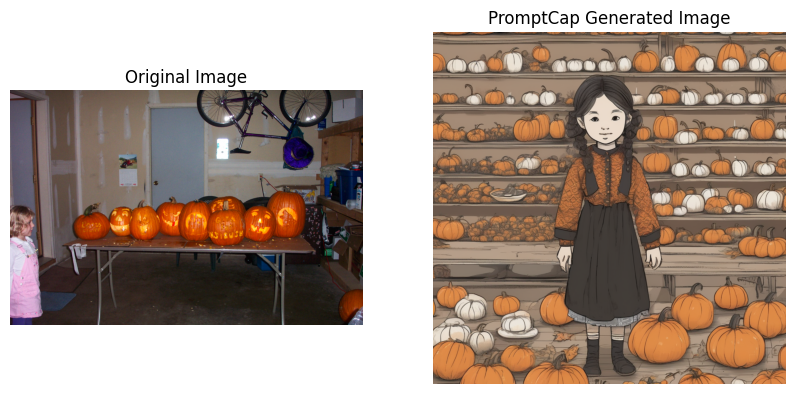





Caption: it really looks great after the painters.

 Initial Prompt Response: a woman walking past a yellow building

 Questions Generated: ["1. What is the expression on the woman's face as she walks down the street?", '2. Can you describe the architectural style of the yellow building in more detail?', '3. What time of day does it seem like in the image, based on the lighting and shadows?', '4. Are there any distinctive features or decorations on the woman or her clothing that can be identified?', '5. Is there any vegetation or greenery visible around the woman or the building?', '6. What can be observed in the background of the image beyond the woman and the yellow building?', '7. Does the woman appear to be carrying anything or holding an object in her hands?', '8. How busy or quiet does the street seem based on the number of people or vehicles present?', '9. Is there any signage or writing visible on the building that could provide further context?', '10. What emotions or feel

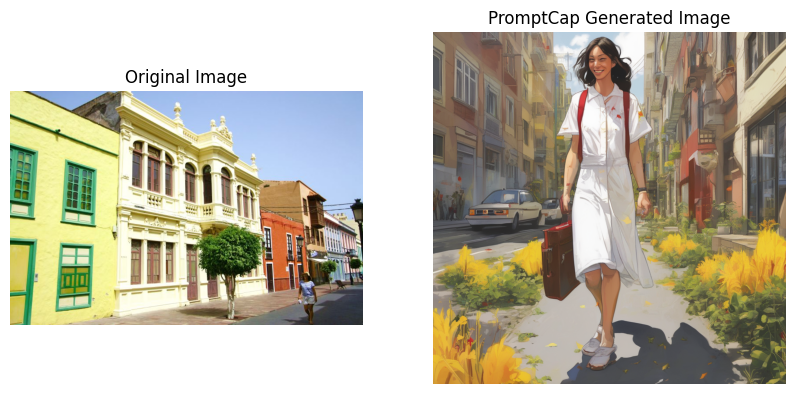





Caption: And i am proud to say that i owned this one.

 Initial Prompt Response: a car driving down a street

 Questions Generated: ['1. What make and model is the car in the image?', '2. Can you describe the condition of the car, such as its color, cleanliness, or any noticeable damages?', '3. What type of police vehicle is the officer standing next to?', 'Is it a patrol car, motorcycle, or something else?', '4. What is the expression on the face of the police officer?', 'Does he seem alert, relaxed, or focused on something else?', '5. Are there any other people or vehicles visible in the image besides the car and the police officer?', '6. What time of day does the scene appear to take place?', 'Can you see any indicators of day or night in the image?', '7. Is there any signage or identifiable landmarks in the image that can help locate the scene geographically?', '8. What is the weather like in the image?', 'Are there any raindrops on the windshield or puddles on the ground?', '9

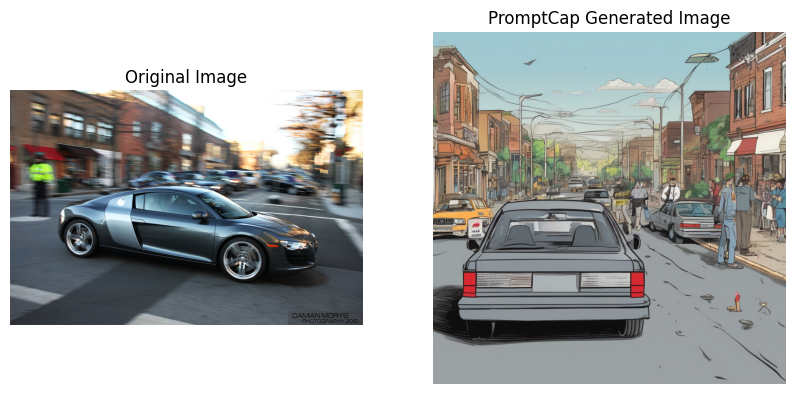





Caption: Today i had a bunch of friends over for a party.

 Initial Prompt Response: a man sitting on a bed with a cup of coffee

 Questions Generated: ["1. What is the expression on the man's face as he holds the cup?", 'Is he looking content, lost in thought, or perhaps sad?', '2. What type of couch is it, and what is its condition?', 'Is it old and worn, or new and modern?', "3. What is the color and texture of the man's clothing?", 'Does it suggest a particular occupation or social status?', "4. What is the room temperature suggested by the man's attire and the presence or absence of a blanket?", '5. What is the time of day indicated by the position of the sun outside the window, if any?', '6. What is the man wearing on his feet?', 'Are they formal shoes, slippers, or barefoot?', "7. Is there anything notable about the man's posture or body language?", 'Does he seem relaxed, tense, or distracted?', '8. What is the material and size of the cup?', 'Is it made of glass, ceramic, o

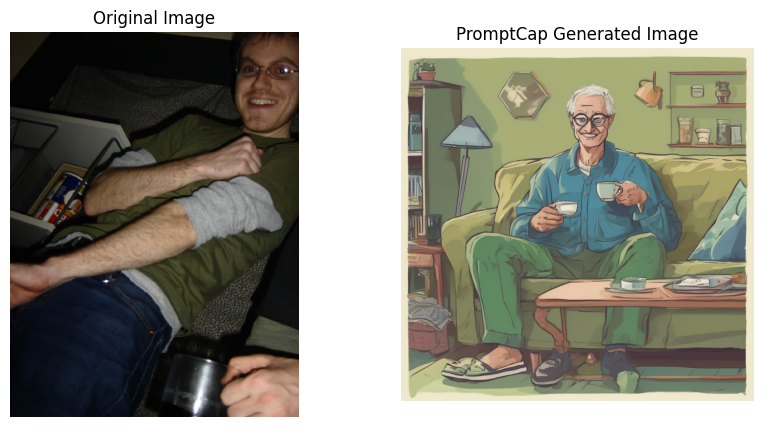





Caption: My little sister had a tiger painted on her.

 Initial Prompt Response: a woman with a mustache painted on her face

 Questions Generated: ['1. What is the reason behind the woman in the image having a mustache painted on her face?', 'Is it part of a costume or a performance?', "2. Can you describe the expression on the woman's face in the image?", 'Does she appear amused, serious, or indifferent about her mustache?', '3. What is the setting of the image?', 'Is the woman in a public place or in a private environment?', "4. Are there any other people or objects present in the image that can provide context to the woman's mustache?", "5. What emotions does the woman's mustache evoke in the viewer?", 'Does it make them laugh, feel confused, or intrigued?', "6. How does the woman's appearance compare to societal norms and expectations regarding femininity?", "7. Is there any symbolism or hidden meaning associated with the woman's mustache in the image?", "8. What materials wer

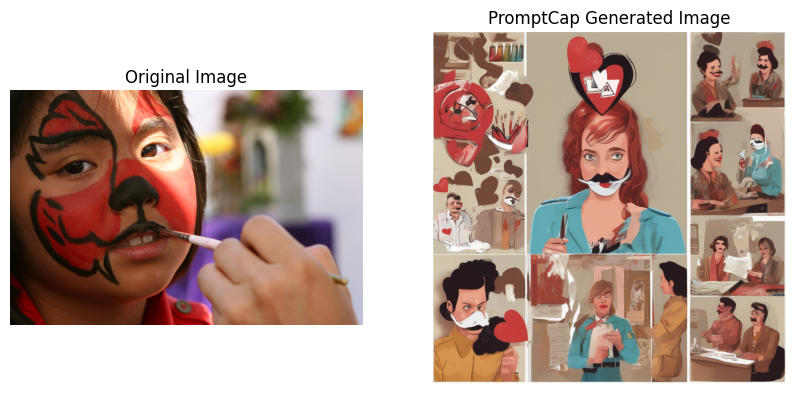





Caption: As was the rest of my extended family!

 Initial Prompt Response: a group of women posing for a picture

 Questions Generated: ['1. What type of clothing are the women wearing, and how does their attire reflect their cultural background or personal styles?', '2. Are there any noticeable expressions or body language among the women that suggest relationships or emotions towards one another?', '3. What is the setting of the photograph - indoors or outdoors?', 'If outdoors, what time of day is it, and what natural elements can be seen in the background?', '4. Is there a clear leader or organizer of the group, or do they all seem equally involved in the photo session?', '5. What props or accessories do the women have with them, and how might these items add meaning to the photograph?', '6. Can you identify any notable facial features or physical characteristics of the women, and how do these differences contribute to the overall composition of the image?', '7. How does the lig

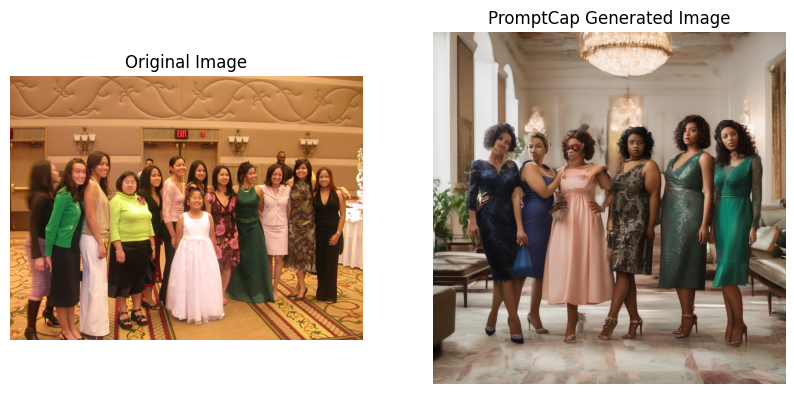





Caption: People are gathered around talking and catching up with their friends.

 Initial Prompt Response: a man in a red shirt and black tie talking to another man

 Questions Generated: ['1. What is the exact color and texture of the red shirt worn by the first man?', "2. Is there any visible brand name or logo on the man in the red shirt's tie?", "3. What are the expressions on both men's faces while they are engaged in conversation?", '4. Are there any noticeable body language cues or gestures between the two men?', '5. What is the setting or background of the scene where this interaction is taking place?', '6. Is there any object or symbol present in the environment that may provide context to their conversation?', '7. What can we infer about their relationship based on their attire, body language, and facial expressions?', '8. Is there any indication of the time of day or weather conditions in the image?', '9. Are there any other people or animals nearby that might be involve

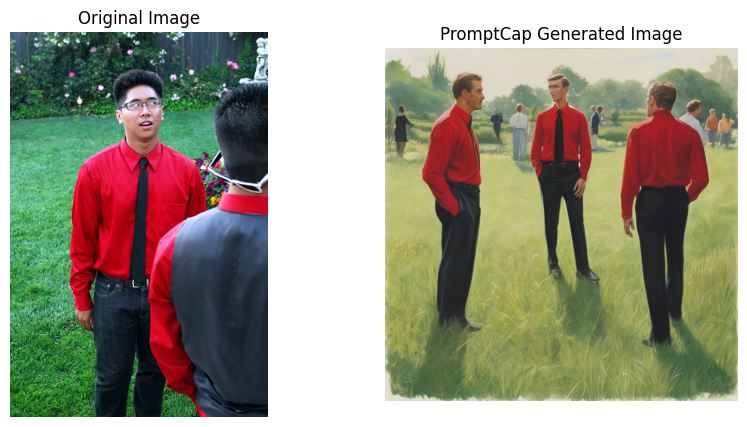





Caption: Today we're teaching you what our company is about.

 Initial Prompt Response: two men in suits and ties standing next to each other

 Questions Generated: ['1. What type of suits are the two men wearing, and what colors do their suits have?', '2. Are there any distinguishing features or accessories on their suits that can be identified?', '3. What expressions are on the faces of the two men, and how do these expressions convey emotion?', '4. Is there a noticeable difference in height between the two men?', 'How does this physical difference affect their body language?', '5. What is the setting or background of the image, and how does it relate to the two men?', '6. Are there any visible signs of interaction or communication between the two men, such as hand gestures or body language?', '7. What might be the reason for the two men being in close proximity to one another?', "8. Is there any indication of time period or era suggested by the men's suits or the overall appeara

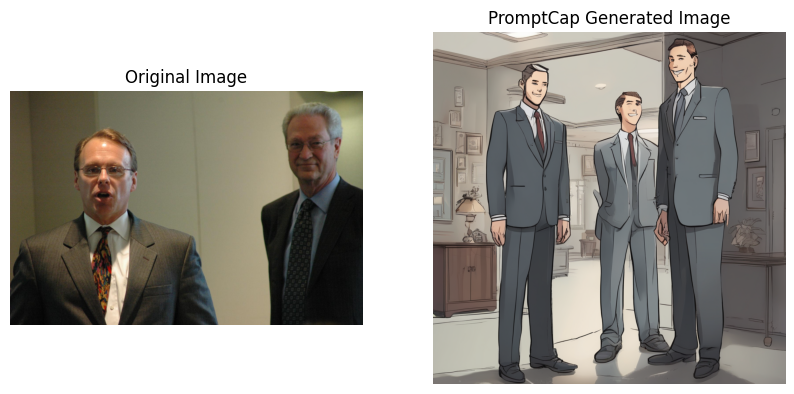





Caption: we saw many people in their day to day lives.

 Initial Prompt Response: a person in a yellow coat walking in the snow

 Questions Generated: ["1. What is the expression on the person's face as they shovel the snow?", 'Are they focused, tired, or perhaps even enjoying the task?', '2. Can you describe the texture and consistency of the snow being shoveled?', 'Is it wet and heavy, or light and powdery?', '3. What is the weather like in the scene?', 'Is it snowing heavily, lightly, or has it recently stopped?', '4. Where is this person located?', 'Is it a residential area, a commercial district, or some other setting?', '5. What is the temperature outside?', 'Is the person wearing gloves, a hat, or any other protective clothing besides the yellow coat?', '6. Why is the person shoveling the snow?', 'Is it their job, a chore they must do, or are they helping a neighbor?', '7. How long has the person been shoveling?', 'Are they almost finished, just starting, or taking a break?'

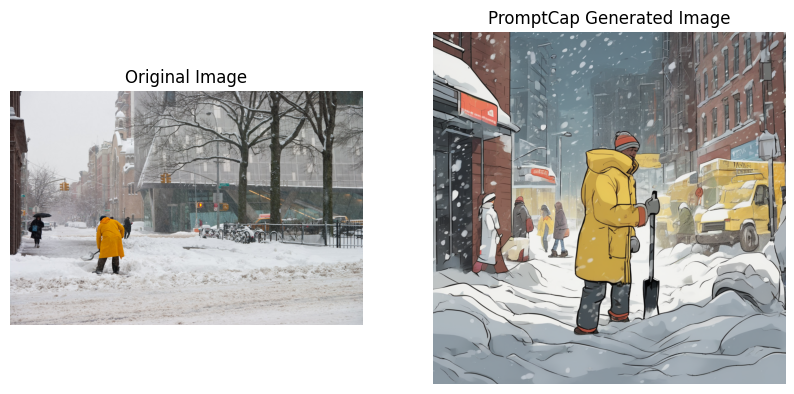





Caption: The houses were old and so charming with their brick facades!

 Initial Prompt Response: a building with a blue sky

 Questions Generated: ['1. What type of building is it, and what architectural style does it exhibit?', '2. Can you describe any distinctive features or structures on the building that make it unique?', '3. Is there any vegetation surrounding the building, and if so, what kind?', '4. How large is the building compared to other structures in the area?', '5. Are there any people or animals present in the scene, and if so, where are they located?', '6. What time of day does the image depict, and how does this affect the lighting and appearance of the building?', '7. Does the building appear abandoned or in use, and what can we infer about its current condition?', '8. What emotions does the blue sky evoke, and how does it contrast with the building?', '9. Are there any reflections or shadows on the building that reveal interesting details?', '10. Is there any ev

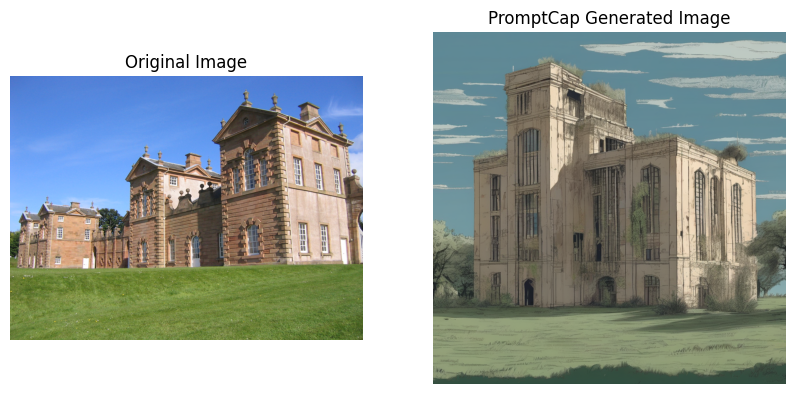





Caption: I decided to hang out with a good friend.

 Initial Prompt Response: a man sitting on a bed with a cup of coffee

 Questions Generated: ["1. What is the expression on the man's face as he holds the cup?", 'Is he looking content, lost in thought, or perhaps sad?', '2. What type of couch is it, and what is its condition?', 'Is it old and worn, or new and modern?', "3. What is the color and texture of the man's clothing?", 'Does it suggest a particular occupation or social status?', "4. What is the room temperature suggested by the man's attire and the presence or absence of a blanket?", '5. What is the time of day indicated by the position of the sun outside the window, if any?', '6. What is the man wearing on his feet?', 'Are they formal shoes, slippers, or barefoot?', "7. Is there anything notable about the man's posture or body language?", 'Does he seem relaxed, tense, or distracted?', '8. What is the material and size of the cup?', 'Is it made of glass, ceramic, or plast

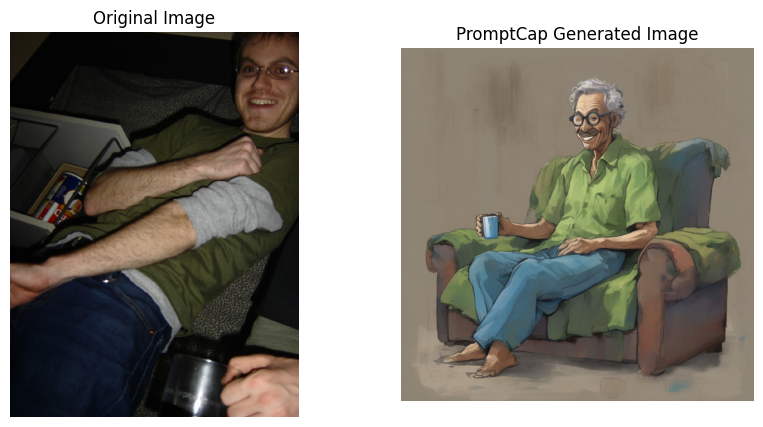





Caption: The men cheered each other on as they received their certificate for the hard work they've done over the past eight weeks.

 Initial Prompt Response: a group of men in military uniforms and a choir setting

 Questions Generated: ['1. What type of military uniforms are the men wearing, and how do their uniforms differ from one another?', '2. Why are these men in military uniforms participating in a choir?', 'Is this a regular occurrence or a special event?', '3. What emotions can be discerned from the facial expressions of each man while they sing?', '4. Are there any visible insignia or symbols on their uniforms that may provide clues about their rank, unit, or branch of the military?', '5. How does the acoustic environment influence the performance of the choir, such as the size and shape of the room, the presence of an audience, or the availability of musical instruments?', '6. Does the choir have a name or a notable history?', 'What is the significance of this choir wit

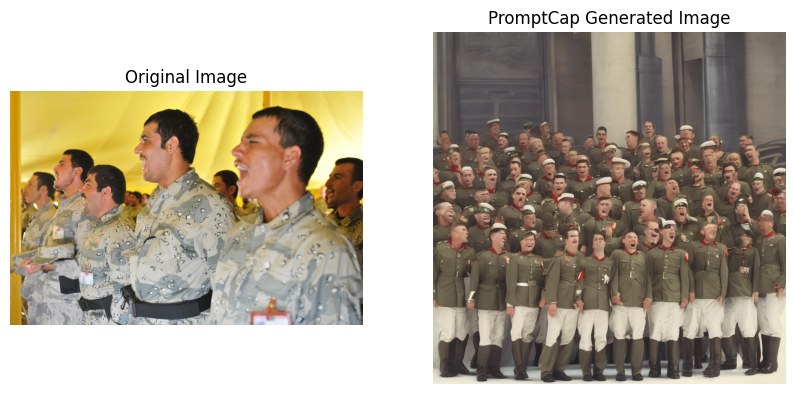





Caption: A fun day of arts and crafts at pre-school.

 Initial Prompt Response: a little girl playing with toys on a table

 Questions Generated: ['1. What specific types of toys is the little girl playing with on the table?', 'Are there any distinctive features or details that make these toys unique?', "2. Can you describe the expression on the little girl's face as she plays with her toys?", 'How does this emotion conveyed through her facial features and body language relate to the overall scene?', '3. What is the condition of the table where the little girl is playing?', 'Is it clean, cluttered, or disorganized?', 'How might this affect her play experience?', '4. Are there any other objects or decorations visible in the background of the image?', 'How do they contribute to the setting and mood of the scene?', '5. Does the little girl appear to be alone while playing, or is there someone else present in the room?', 'How does their presence (or absence) influence her behavior and 

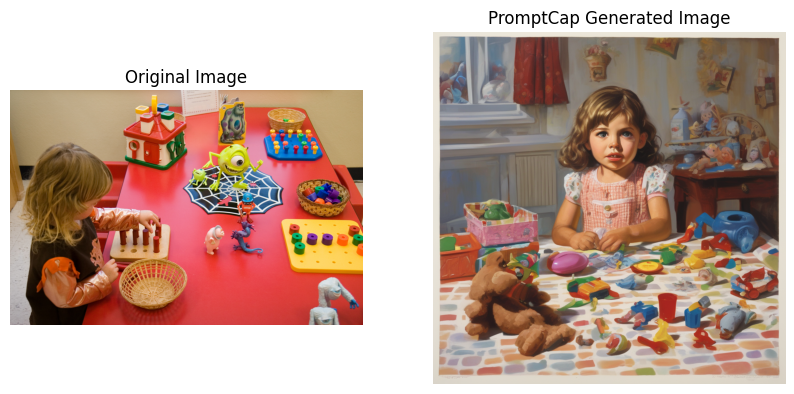





Caption: A lone bicyclist closed in the ranks at the end.

 Initial Prompt Response: a man riding a bicycle on a city street

 Questions Generated: ['1. What specific color shades does the rainbow flag display in the image?', '2. Is the man wearing any distinctive clothing or accessories while riding the bike?', "3. What is the expression on the man's face as he rides his bike?", '4. Are there any other people or objects visible in the background of the image?', '5. Does the rainbow flag appear to be attached to a building, a pole, or something else?', '6. How does the weather look like in the rest of the scene apart from the rainbow flag?', '7. Is the man carrying any bags or items with him while riding the bike?', '8. What is the condition of the road and the surrounding environment?', '9. Is there any symbolism or meaning associated with the man riding a bike with a rainbow flag?', '10. Can you identify any particular cultural or social significance of the rainbow flag in this c

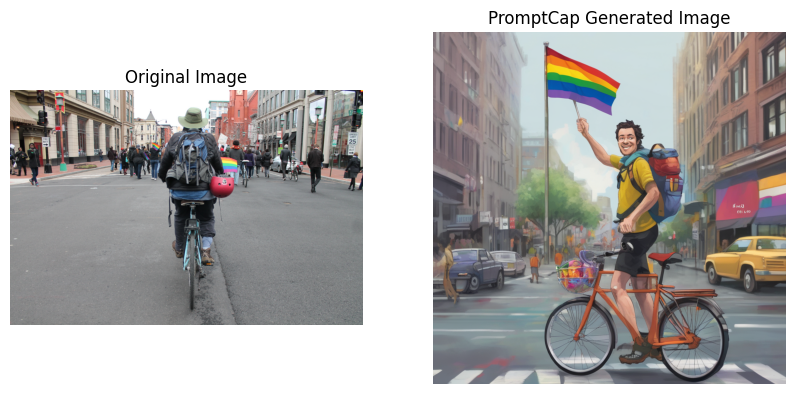





Caption: And then there's the team clown, already cracking jokes, holding up the peace sign.

 Initial Prompt Response: a woman holding a peace sign in a restaurant

 Questions Generated: ["1. What is the expression on the woman's face as she makes the peace sign?", 'Is it sincere or ironic?', '2. Why does the woman choose to make the peace sign in this particular setting - a restaurant?', '3. Are there any other people in the restaurant who notice her gesture?', 'How do they react?', '4. What is the decor and ambiance of the restaurant like?', 'Does it contribute to the overall meaning of the image?', '5. What is the woman wearing?', 'Does her attire provide any clues about her personality or background?', '6. Is there anything unusual or noteworthy about the restaurant itself, such as its architecture, menu, or clientele?', '7. What is the time of day or day of the week depicted in the image?', 'How might this influence the scene?', '8. Are there any other symbols or gestures pre

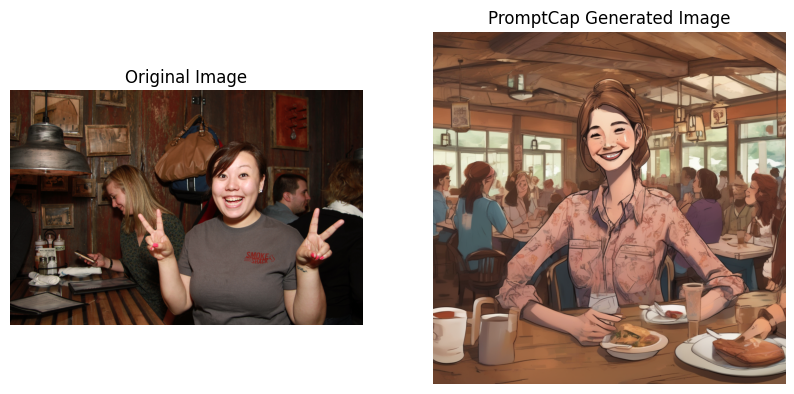





Caption: And of course Bob dosed off on grandpas favorite chair.

 Initial Prompt Response: a man sitting in a chair with his eyes closed

 Questions Generated: ['1. What expression does the man have on his face when his hand is not covering it?', '2. Is there any visible indication of where the man is (e.g., indoor or outdoor setting)?', '3. What type of chair is the man sitting in and what condition is it in?', "4. Are there any visible signs of fatigue or exhaustion on the man's face?", '5. Does the man appear to be deep in thought or lost in thought, or is he simply resting?', '6. Is there any visible object nearby that may suggest why the man is sleeping in the chair?', '7. What time of day do you think this scene takes place based on the available visual clues?', "8. Is there any visible indication of the man's age, occupation, or social status?", "9. How does the man's posture and position in the chair affect your interpretation of the scene?", "10. Are there any subtle deta

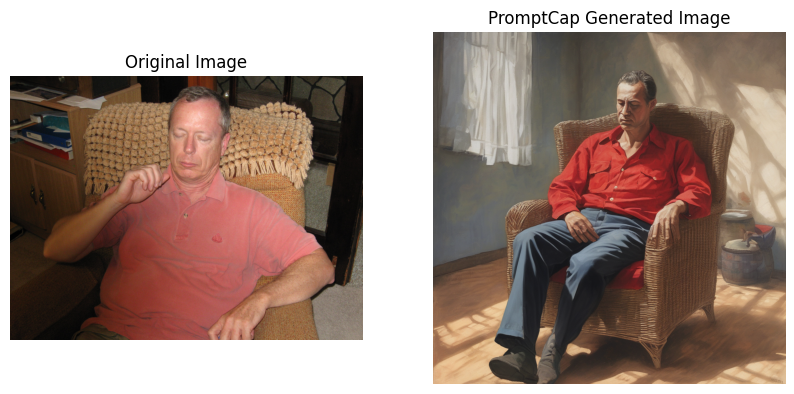





Caption: I thought about the play for a while after I saw it.

 Initial Prompt Response: a group of elves sitting in a room with books

 Questions Generated: ['1. What specific activities are the elves engaged in while seated in the room?', '2. How many elves are there in the group and what are their expressions suggesting?', '3. What are the elves wearing and how does their attire reflect their culture or social status?', '4. Is there any noticeable difference in age or appearance among the elves?', '5. Are there any distinct features or symbols present in the room that may indicate its purpose or significance to the elves?', '6. What is the lighting condition in the room and how does it contribute to the overall mood?', '7. Are there any windows or sources of natural light in the room?', '8. What kind of furniture or decorations can be seen in the room?', '9. Is there any evidence of food or drink present, indicating a meal or feast?', "10. Are there any notable items or tools sc

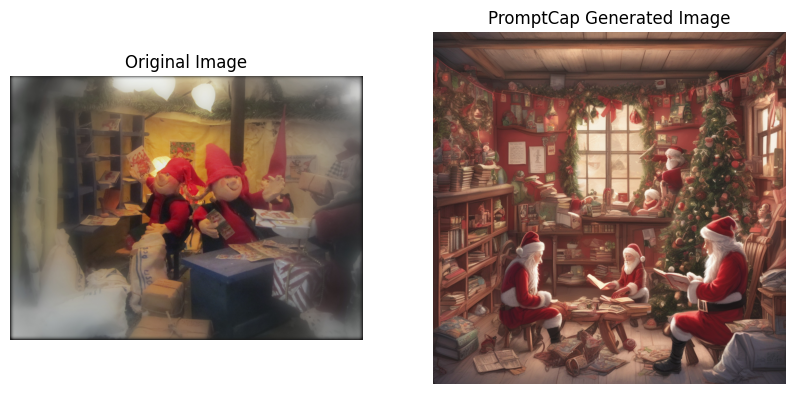





Caption: there is great history about this grave yard

 Initial Prompt Response: a large tree in a park with a sense of movement

 Questions Generated: ['1. What type of gate is it, and what material is it made of?', '2. Is there any text or symbols visible on the gate?', '3. What kind of tree is in the background, and how old does it appear?', '4. Are there any other trees or vegetation nearby, and how do they compare to the tree in the background?', '5. What is the condition of the gate - is it rusty, weathered, or well-maintained?', '6. Is there any sign of human presence around the gate or tree?', '7. How does the sunlight interact with the gate and tree, and what effect does this have on the overall scene?', '8. Does the tree seem to be growing through or around the gate, and if so, how long has this been happening?', '9. Is there any evidence of wildlife living in or near the tree or gate?', '10. What emotions does the image evoke, and why might that be?', '11. Is there any c

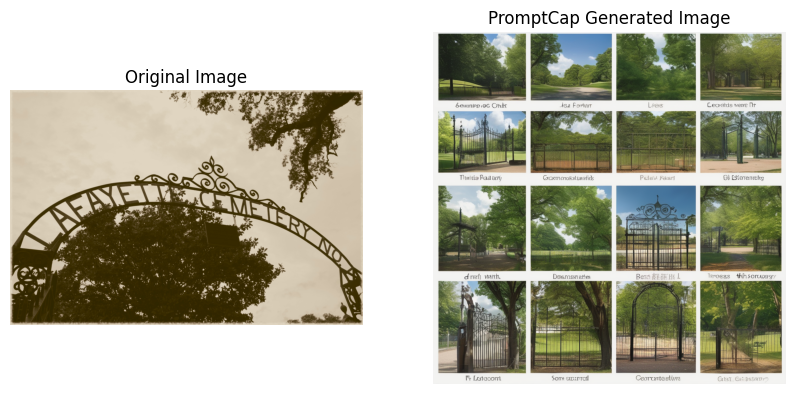





Caption: Miranda smiles at me before the party began.

 Initial Prompt Response: a little girl with curly hair smiling

 Questions Generated: ["1. What is the expression on the little girl's face that makes her smile?", 'Is it due to something she sees, hears, or feels?', "2. What color is the little girl's dress and how does it complement the colors of the park around her?", "3. Are there any animals or other people present in the park that might have contributed to the little girl's happiness?", "4. What time of day is it in the image, and how does the lighting affect the scene and the little girl's appearance?", '5. Does the little girl seem to be alone or with someone, and if so, who is it and what is their relationship to her?', '6. What activities can we see the little girl engaged in that might explain her joyful expression?', '7. How old do you estimate the little girl to be based on her appearance and size compared to common references?', '8. What emotions might the photog

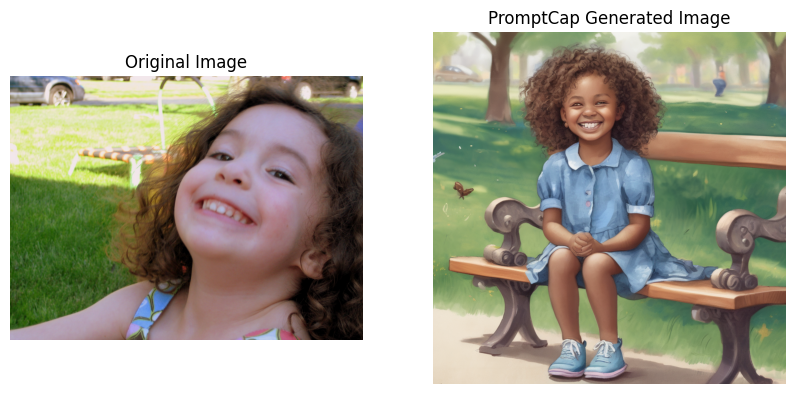





Caption: What did matter was that when they sat and though, their play ground seemed to be missing something. 

 Initial Prompt Response: a group of children sitting on the ground

 Questions Generated: ['1. What type of ball is it that the children are playing with?', '2. How many children are there in the group and what are their ages approximately?', '3. Where exactly is this scene taking place - indoors or outdoors?', '4. What expressions can be seen on the faces of the children?', 'Are they happy, focused, tired, or something else?', '5. Is anyone holding the ball or passing it to another child?', 'If so, who?', '6. What clothing items can be observed on the children?', 'Are they dressed appropriately for the weather?', '7. Is there any vegetation or other natural features visible in the background?', '8. Can you make out any distinguishing features of the children, such as hairstyles or accessories?', '9. Is there any evidence of adults present in the scene?', '10. What emoti

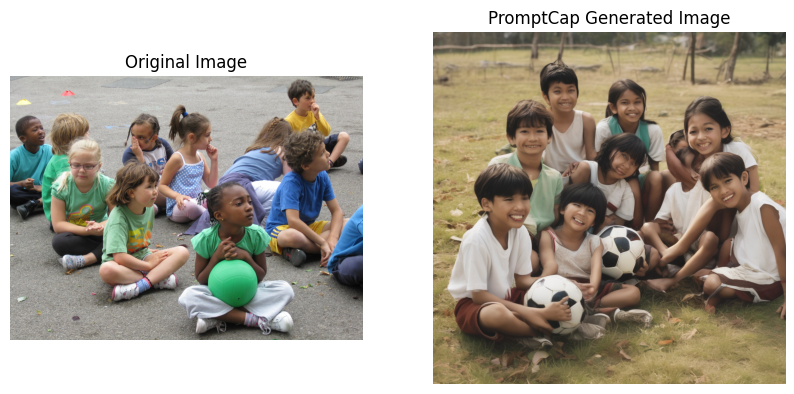





Caption: Look at all the cute ducklings. My kids love them.

 Initial Prompt Response: a group of children standing on a sidewalk with ducks

 Questions Generated: ['1. What types of activities are the children engaged in with the ducks in the park?', '2. How many children and ducks can be seen in the image?', '3. What expressions do the children have on their faces as they interact with the ducks?', '4. Are there any noticeable differences in the behavior of the children towards the ducks?', '5. What emotions does the scene evoke in you, and why?', '6. Is there any visible body language or posture from the children that suggests their feelings towards the ducks?', '7. What is the age range of the children, and how does this influence their interaction with the ducks?', '8. Are there any notable features or accessories on the children that provide insight into their backgrounds or social statuses?', '9. What is the weather like in the park, and how does it affect the children and d

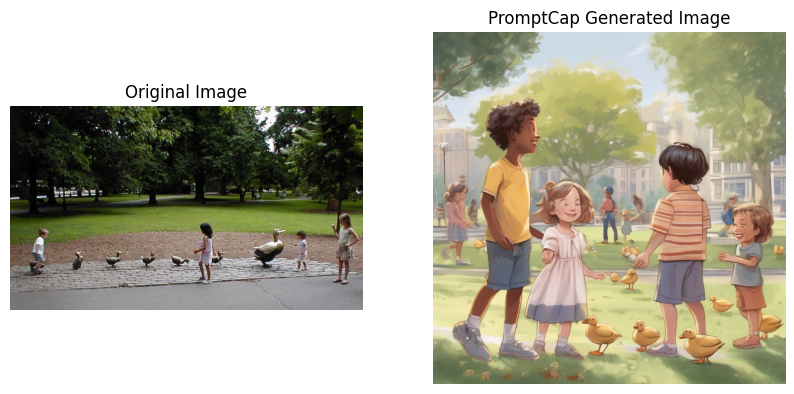





Caption: They had a good time sparing mostly.

 Initial Prompt Response: a group of people in martial arts fights

 Questions Generated: ['1. What type of martial arts are the individuals practicing, as indicated by their uniforms?', '2. Are there any distinct emblems or insignia on their uniforms that suggest affiliation with a particular school or organization?', '3. What weapons, if any, are they using during the fight?', '4. Is this a friendly sparring match or a more serious competition?', 'How can you tell?', '5. What is the setting of the fight – indoors or outdoors?', 'What does the environment add to the scene?', '6. Can you identify any notable facial expressions or body language among the fighters, suggesting their emotions or intentions?', '7. Are there any spectators or referees present, and how do they react to the fight?', '8. What is the overall atmosphere of the scene – tense, playful, intense, etc.?', '9. Are there any power dynamics evident between the fighters, 

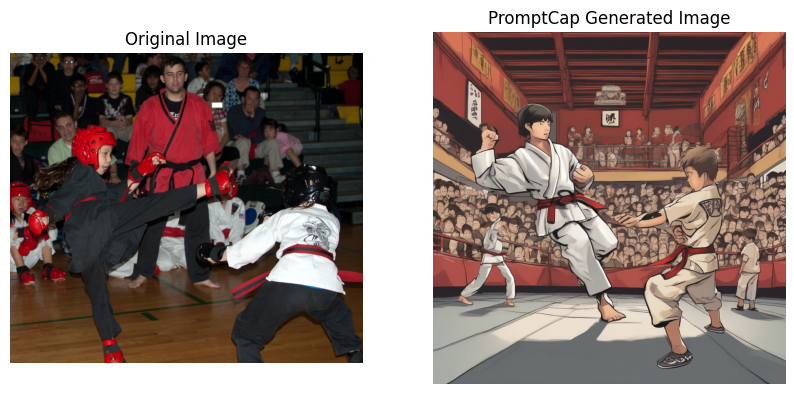





Caption: The flowers at their reception were a beautiful orange with pink accents. 

 Initial Prompt Response: a flower with two rings on it

 Questions Generated: ['1. What type of orange flower is this, and how can we identify it based on its appearance in the image?', '2. How many rings are there in total, and what materials do they appear to be made of?', '3. Are the rings stacked on top of each other or arranged side by side?', 'Why might they be positioned in this way?', '4. Is there any visible texture or pattern on the surface of the orange flower that could provide context for the placement of the rings?', '5. Does the arrangement of the rings suggest any symbolic meaning or significance within the context of the image?', '6. What emotions does the image evoke, and how might the presence of the rings and orange flower contribute to these feelings?', '7. Is there any evidence of a human hand or other object in the image that might have placed the rings on the flower?', '8. 

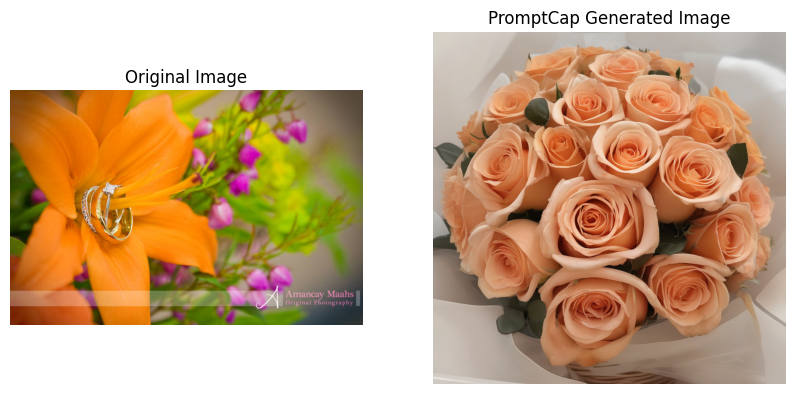





Caption: The balloon artist has arrived, let the fun begin.

 Initial Prompt Response: a man and a woman standing in the grass the woman is wearing a balloon hat

 Questions Generated: ['1. What type of balloon hat is the woman wearing, and what color is it?', '2. How does the man look towards the woman, and what expression does he have on his face?', '3. Is there any particular activity or event happening in the park that the man and woman seem to be part of?', '4. What are the expressions on the faces of other people in the park, if any, visible in the image?', '5. Are there any notable features or landmarks in the park setting that can be identified?', '6. What time of day does the scene appear to take place, based on the position of the sun or other environmental clues?', '7. Does the man or woman seem to be holding anything in their hands?', 'If so, what are those items?', '8. What emotions or feelings do you think the man and woman might be experiencing based on their body la

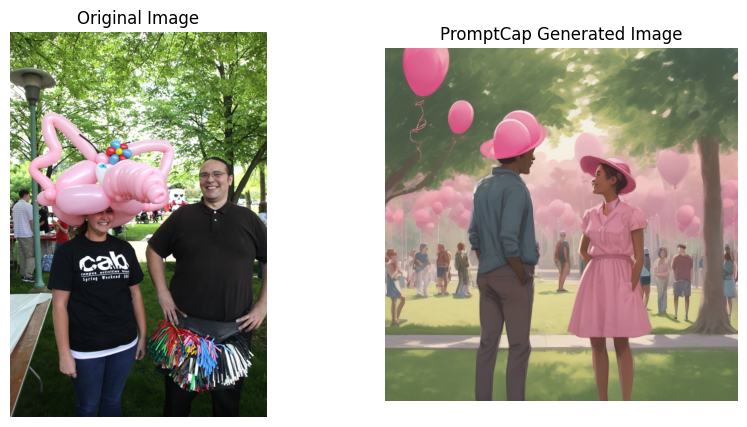





Caption: and also enjoying drinks.

 Initial Prompt Response: a woman holding a glass of water in a crowded room

 Questions Generated: ["1. What is the expression on the woman's face as she holds the glass of water?", 'Is she looking content, lost in thought, or perhaps distressed?', '2. Who are the other people in the room, and what are they doing?', 'Are they interacting with each other, or are they focused on their own tasks?', "3. What is the temperature and humidity level in the room suggested by the condensation on the woman's glass?", '4. Is there any visible source of light in the room, and how does it affect the mood and ambiance?', '5. What type of room is it, and what can we infer about its purpose based on the presence of the people and the woman?', '6. Does the woman appear to be alone or part of a group?', 'How does her isolation (or lack thereof) influence the interpretation of the scene?', '7. What is the significance of the woman holding a glass of water in this c

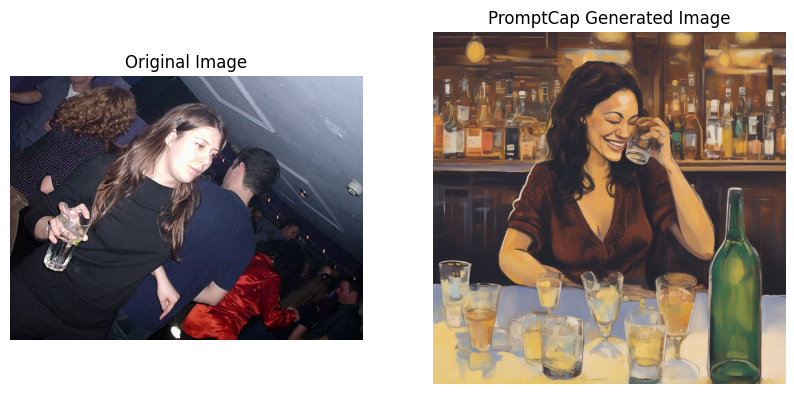





Caption: Mindy had been working hard to get through college. It was finally graduation. She walked up to the stage excitedly.

 Initial Prompt Response: a group of people in graduation caps and gowns

 Questions Generated: ['1. What type of event is this group of people attending, indicated by their graduation caps and gowns?', '2. Can you identify any distinguishing features or symbols on the graduation caps or gowns that may suggest which institution or program they represent?', '3. How many people are there in total, and what seems to be their age range or demographic makeup?', '4. Is there a noticeable difference in expressions or body language among the individuals, suggesting varying levels of excitement or apprehension?', '5. Are there any notable props, decorations, or landmarks visible in the background that can provide context to the setting of the event?', '6. What is the weather like, as suggested by the appearance of the people and their surroundings?', '7. Is there an

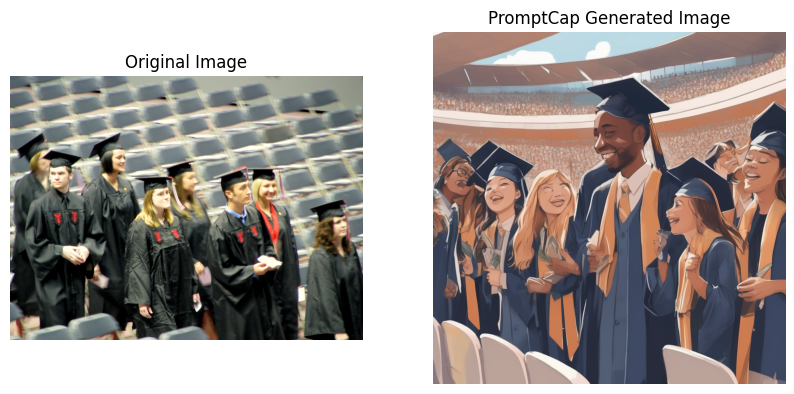





Caption: There was a lot of fun to be had.

 Initial Prompt Response: a group of people in a living room with memories, feelings, and feelings

 Questions Generated: ['1. What type of music is the woman singing, and how can we tell?', '2. Are there any instruments accompanying her song, and if so, who is playing them?', '3. What are the expressions on the faces of the people in the audience?', 'How do they differ from one another?', '4. Is there any body language or gestures from the singer or audience members that add meaning to the scene?', '5. What are the decorative features of the living room, and how do they contribute to the overall ambiance?', '6. Is there any evidence of food or drink present, suggesting this is a social gathering or celebration?', '7. What are the clothing styles of both the singer and the audience members, and what cultural or historical significance might they hold?', '8. Does the lighting in the room create any interesting shadows or highlights, and ho

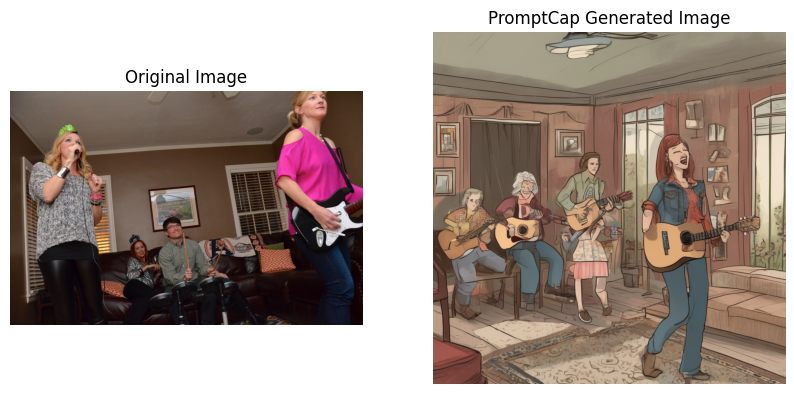





Caption: Overall, the tree was firmly planted and ready to start growing tall.

 Initial Prompt Response: a tree growing in a hole

 Questions Generated: ['1. What type of tree is it, and how can you identify its species based on its appearance in the image?', "2. How large is the hole in the ground, and what does its size suggest about the tree's age or growth conditions?", '3. Is there any vegetation or other plants growing around the tree or in the hole?', 'If so, what types are they, and how do they interact with the tree?', '4. Are there any visible signs of human activity near the tree, such as footprints, tools, or discarded items?', '5. What is the texture and color of the soil surrounding the tree and in the hole?', 'Does this provide any clues about the environmental conditions?', '6. Is the tree leaning or growing at an angle, and if so, why might this be happening?', '7. What is the weather like in the image, and how does it affect the tree and the hole?', '8. Are there

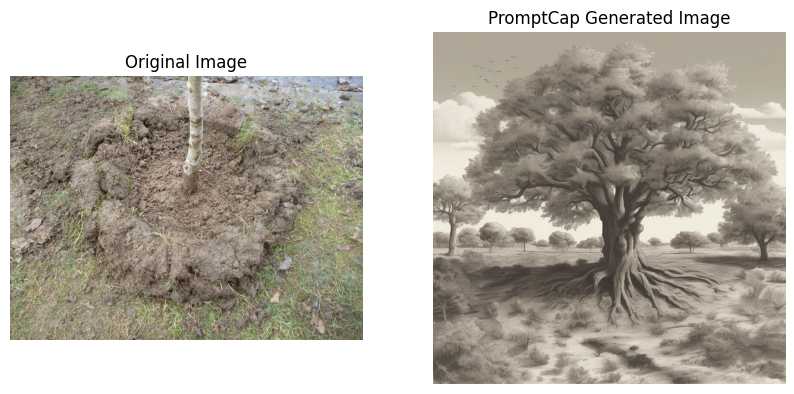





Caption: We walked through the park and saw some beautiful flowers along the way. 

 Initial Prompt Response: a group of yellow flowers

 Questions Generated: ['1. What type of yellow flowers can be identified in the image?', '2. How many flowers are there in the group?', '3. Is there any particular arrangement of the flowers in the group?', '4. Are there any other colors present in the image apart from yellow?', '5. What is the texture of the petals and leaves of the flowers?', '6. Is there any visible sign of pollination on the flowers?', '7. Can you identify any insects or animals interacting with the flowers?', '8. What is the size of each flower relative to other flowers in the field?', '9. Is there any noticeable difference in color or condition between the flowers in the group?', '10. What is the weather like in the image, based on the appearance of the flowers and the surrounding environment?', '11. Does the image suggest any particular time of day or season based on the po

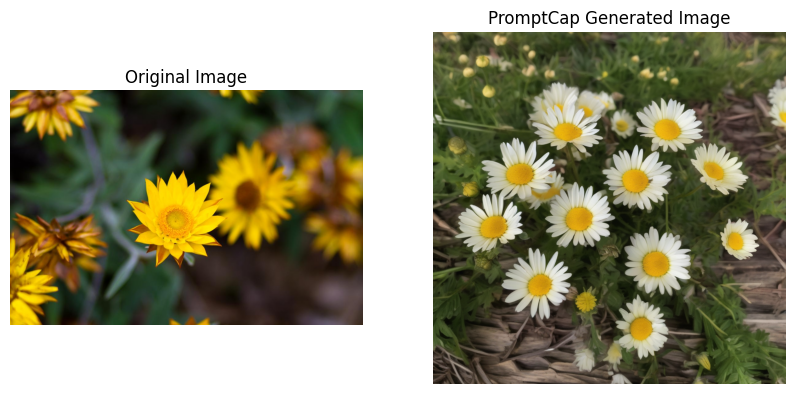





Caption: At night our relatives left and we enjoyed a nice quiet dinner. It was a nice day. 

 Initial Prompt Response: a group of people sitting around a table in a clean room

 Questions Generated: ['1. What type of furniture is the table made of, and what is its condition?', '2. How many people are there in the group, and what are their ages, genders, and appearances?', '3. Are they all facing each other, or does the seating arrangement vary?', '4. What are they doing – eating, playing cards, having a serious discussion, or something else?', '5. Is there any visible decoration or artwork on the walls, and if so, what style does it represent?', '6. What is the lighting like in the room – natural light, artificial light, or a combination?', '7. Are there any windows or doors present, and what can be seen through them?', '8. Is there any food or drink on the table, and what types are they?', '9. Are there any pets or animals present in the room?', '10. What emotions can be discerne

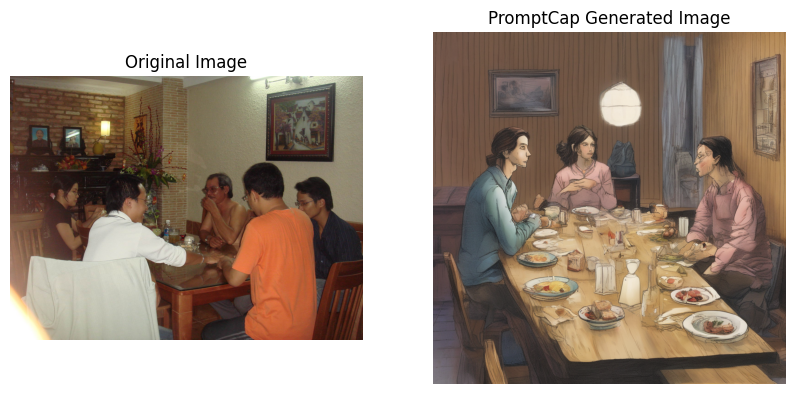





Caption: Today was the day of the polar plunge for charity!

 Initial Prompt Response: two men standing on a dock

 Questions Generated: ['1. What types of clothing and accessories can be observed among the crowd of people on the dock?', '2. Are there any noticeable expressions or body language among the individuals in the crowd that suggest their emotions or thoughts?', '3. What is the weather like, as indicated by the appearance of the people and their surroundings?', '4. What are the two men doing on top of the structure, and how do they seem to interact with one another?', '5. Is there any visible signage, markings, or other identifying features on the dock or surrounding area?', '6. How does the size and composition of the crowd suggest the purpose or nature of the gathering?', '7. Are there any boats or watercraft present in the scene, and if so, what role might they play in the context of the image?', '8. What materials or textures can be seen in the construction of the dock

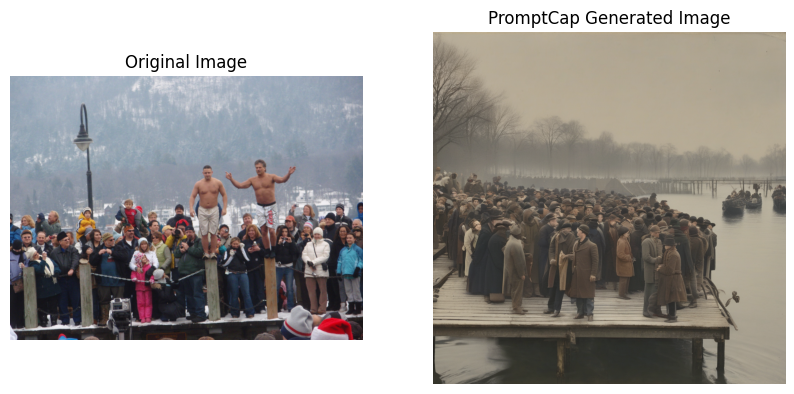





Caption: I threw a Halloween party at my house yesterday.

 Initial Prompt Response: a group of people wearing costumes and lighting

 Questions Generated: ['1. What types of costumes are each person wearing in the group photo?', '2. Can you identify any distinctive features or symbols on their costumes?', '3. What emotions do the individuals appear to be expressing in the photograph?', '4. Is there a common theme among the costumes, suggesting a particular event or occasion?', '5. Are there any props or accessories accompanying the costumes that add to the scene?', '6. How does the setting (background) contribute to the overall feel and meaning of the image?', '7. Do any facial expressions or body language suggest hidden meanings or inside jokes among the group?', '8. What can we infer about the cultural background or time period of the image based on the costumes?', '9. Are there any notable differences or similarities between the costumes of different individuals in the group?',

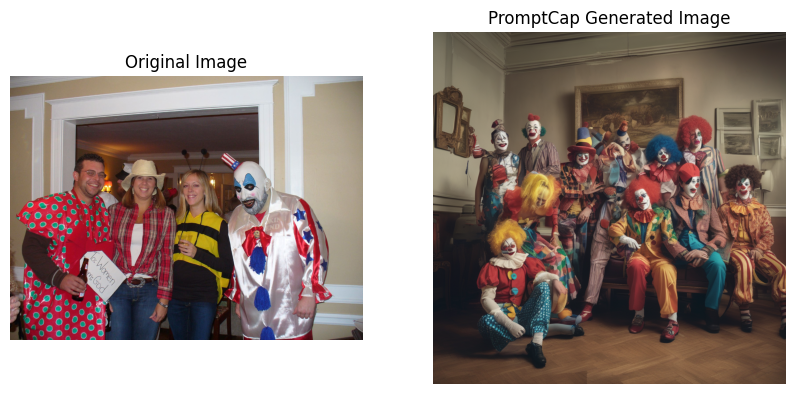





Caption: After the wedding photos were taken with the bride and groom.

 Initial Prompt Response: a bride and groom sitting in the grass

 Questions Generated: ['1. What type of flowers can be seen surrounding the bride and groom in the grass?', '2. Can you describe the expressions on the faces of the bride and groom as they sit in the grass?', '3. What is the weather like in the scene, as indicated by the appearance of the grass and other elements?', '4. Are there any notable features or decorations visible in the scene that suggest the location of the wedding ceremony?', '5. How does the positioning of the bride and groom in relation to each other and their surroundings convey their emotions towards one another?', '6. Is there any evidence of other people present in the scene, such as photographers or guests?', '7. What textures and colors can be observed in the grass itself, and how do these contribute to the overall aesthetic of the image?', '8. Are there any animals or other c

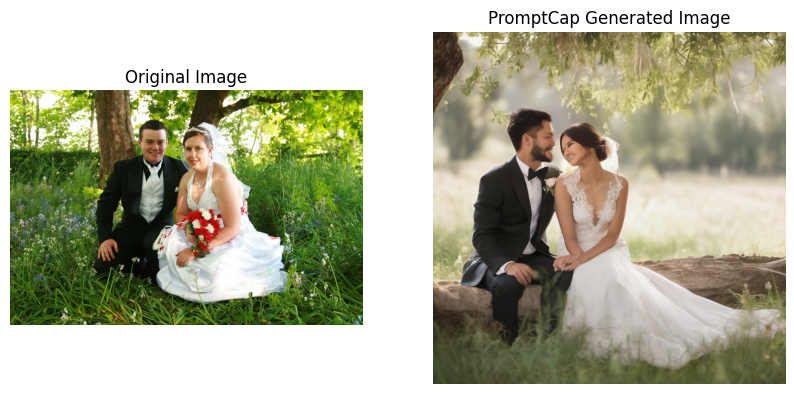





Caption: I watched the parade for hours.

 Initial Prompt Response: a man pulling a cart with a plant on it

 Questions Generated: ['1. What type of plant is the man transporting in his cart?', '2. Where is the man headed with the cart and the plant?', '3. How large is the plant compared to the size of the man and the cart?', '4. Is the man alone, or does he have any companions or animals assisting him?', '5. What expression does the man have on his face as he pulls the cart?', '6. Is the terrain smooth or rough for the man to navigate while pulling the cart?', '7. Does the cart appear to be loaded with only the plant, or are there other items present?', '8. What is the weather like in the scene, and how does it affect the man and the plant?', '9. Are there any notable features or structures visible in the background of the image?', '10. What emotions might the man be experiencing as he pulls the cart, given the presence of the plant?', '11. Is the plant in a pot or directly plante

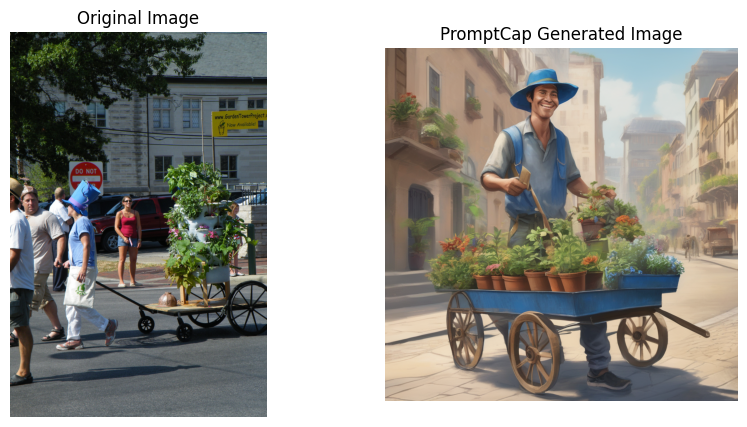

In [48]:
for result in results:
    print("Caption:", result['caption'])
    print("\n Initial Prompt Response:", result['initial_prompt_response'])
    print("\n Questions Generated:", result['questions'])
    print("\n PromptCap Responses:", result['promptcap_response'])
    print("\n Concise Response from GPT:", result['concise_response'])
    print("\n CLIP Similarity Score:", result['clip_score'])
    display_images(result['url'], result['generated_image_bytes'])
    print("\n\n\n")